#### This code reproduces the findings of the following scientific article, accepted for publication in npj Materials Degradation journal on 25 September 2023:
### Estimating pitting descriptors of 316L stainless steel by machine learning and statistical analysis
#### _Leonardo Bertolucci Coelho$^{1,2,*}$, Daniel Torres$^{1}$, Vincent Vangrunderbeek$^{2}$, Miguel Bernal$^{1}$, Gian Marco Paldino$^{3}$, Gianluca Bontempi$^{3}$, Jon Ustarroz$^{1,2}$_ 

_$^{1}$ChemSIN – Chemistry of Surfaces, Interfaces and Nanomaterials, Université libre de Bruxelles (ULB), Brussels, Belgium_ 

_$^{2}$Research Group Electrochemical and Surface Engineering (SURF), Vrije Universiteit Brussel, Brussels, Belgium_

_$^{3}$Machine Learning Group (MLG), Université libre de Bruxelles (ULB), Brussels, Belgium_

_*leonardo.bertolucci.coelho@ulb.be_

# 0.05 M NaCl, 100 mV/s

In [1]:
# Import the required libraries
import os
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

import sklearn
from scipy.stats import kde
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import warnings
from sklearn import metrics
from sklearn.metrics import r2_score
from scipy.signal import argrelmax

In [2]:
# machine learning libraries
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from tensorflow import keras 
import tensorflow as tf
from sklearn.model_selection import KFold

In [3]:
pip install -q tensorflow-model-optimization

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
# Implement a Custom Metric Function in Keras
from keras import backend as K

def coeff_determination(y_true, y_pred):
    SS_res =  K.sum(K.square( y_true-y_pred )) 
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) ) 
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

### datasets uploaded below can be downloaded at: https://data.mendeley.com/datasets/78rz8vw46x/2
Bertolucci Coelho, Leonardo (2023), “Micro-scale potentiodynamic polarisation curves of 316L stainless steel ”, Mendeley Data, V2, doi: 10.17632/78rz8vw46x.2

In [355]:
# choosing the directory for uploading the datasets
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\paper1")

# getting the current directory
%pwd

'C:\\Users\\lbertolu\\OneDrive - Vrije Universiteit Brussel\\ULB\\SECCM tests\\pitting statistics paper draft\\paper1'

In [356]:
df_E=pd.read_csv('E(V)_0.05_M_NaCl_100_mV_per_s.csv') 
E=df_E["E (V)"]
E

0       0.500809
1       0.501724
2       0.502335
3       0.503250
4       0.503861
          ...   
1102    1.350444
1103    1.351360
1104    1.351970
1105    1.352885
1106    1.353496
Name: E (V), Length: 1107, dtype: float64

In [357]:
df=pd.read_csv('j_uA-cm2_0.05_M_NaCl_100_mV_per_s.csv') 
df

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,120,121,122,123,124
0,87.429094,87.429094,97.143431,77.714748,29.143030,68.000404,126.286465,77.714748,233.144239,136.000808,...,68.000404,145.715152,87.429094,58.286061,77.714748,NaN,19.428687,19.428687,68.000404,38.857374
1,58.286061,77.714748,116.572118,106.857775,97.143431,136.000808,87.429094,77.714748,136.000808,145.715152,...,29.143030,NaN,38.857374,NaN,NaN,68.000404,NaN,NaN,NaN,NaN
2,87.429094,136.000808,68.000404,106.857775,87.429094,106.857775,97.143431,116.572118,174.858185,165.143842,...,NaN,58.286061,58.286061,38.857374,87.429094,87.429094,NaN,29.143030,77.714748,NaN
3,58.286061,116.572118,136.000808,145.715152,145.715152,116.572118,145.715152,116.572118,106.857775,165.143842,...,77.714748,NaN,87.429094,136.000808,38.857374,29.143030,126.286465,38.857374,NaN,97.143431
4,116.572118,126.286465,77.714748,106.857775,48.571714,48.571714,48.571714,116.572118,145.715152,155.429498,...,38.857374,77.714748,NaN,NaN,NaN,NaN,87.429094,48.571714,19.428687,48.571714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,108373.216245,81347.907950,169068.433934,84971.359891,34524.775157,202252.631090,212112.690434,84475.929652,102437.749093,231240.221157,...,6090.893413,73411.293389,6343.466260,9947.487929,6430.895163,18282.393783,26228.726982,119826.422935,6188.036816,13337.792840
1103,120516.136797,92946.833723,162025.528491,79016.469470,44899.697559,203437.775190,194772.587497,69185.551396,62851.802182,246831.739664,...,6256.037038,76325.595467,5624.604762,11161.780303,8150.333867,17835.534768,21585.270746,95210.278028,10025.202015,4653.170418
1104,139721.398794,93413.122693,160675.232489,74713.018485,57790.630428,286388.564403,227665.346487,69350.693748,52865.456574,280890.248133,...,6149.179136,86418.794521,6168.608135,13590.366005,8412.620895,18379.536868,28171.595353,58907.777171,9082.910532,25509.864848
1105,151563.185461,116941.262127,178539.913301,78589.039772,61365.508281,228617.350878,220496.164329,86292.511440,74343.868144,306196.097352,...,5877.177927,54526.610827,5906.320471,15183.519081,8781.765825,16932.100010,20108.691344,103535.472566,7810.331798,20351.549373


#### filling missing values of j

In [358]:
# Multivariate imputer that estimates each feature from all the others.
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

iter_imputer = IterativeImputer()

# The Iterative Imputer models each feature with missing values as a function of other features, iteratively.
j_nan_filled=iter_imputer.fit_transform(df)
df=pd.DataFrame(j_nan_filled,columns=df.columns)

In [359]:
df_log=np.log10(df)

In [360]:
iter_imputer_log = IterativeImputer()

j_nan_filled_log=iter_imputer_log.fit_transform(df_log)
df_log=pd.DataFrame(j_nan_filled_log,columns=df_log.columns)
df_log

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,120,121,122,123,124
0,1.941656,1.941656,1.987413,1.890503,1.464535,1.832511,2.101357,1.890503,2.367625,2.133541,...,1.832511,2.163505,1.941656,1.765565,1.890503,1.735139,1.288443,1.288443,1.832511,1.589473
1,1.765565,1.890503,2.066595,2.028806,1.987413,2.133541,1.941656,1.890503,2.133541,2.163505,...,1.464535,1.495857,1.589473,1.685584,1.245699,1.832511,1.417575,2.331117,2.067738,1.649075
2,1.941656,2.133541,1.832511,2.028806,1.941656,2.028806,1.987413,2.066595,2.242686,2.217862,...,1.607625,1.765565,1.765565,1.589473,1.941656,1.941656,1.873398,1.464535,1.890503,1.610265
3,1.765565,2.066595,2.133541,2.163505,2.163505,2.066595,2.163505,2.066595,2.028806,2.217862,...,1.890503,1.714874,1.941656,2.133541,1.589473,1.464535,2.101357,1.589473,1.478310,1.987413
4,2.066595,2.101357,1.890503,2.028806,1.686383,1.686383,1.686383,2.066595,2.163505,2.191533,...,1.589473,1.890503,1.824829,2.081042,1.289146,1.644666,1.941656,1.686383,1.288443,1.686383
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,5.034922,4.910346,5.228063,4.929273,4.538131,5.305894,5.326567,4.926733,5.010460,5.364063,...,3.784681,4.865763,3.802327,3.997713,3.808271,4.262033,4.418777,5.078553,3.791553,4.125084
1103,5.081045,4.968235,5.209583,4.897718,4.652243,5.308432,5.289528,4.840015,4.798318,5.392401,...,3.796299,4.882670,3.750092,4.047733,3.911175,4.251286,4.334158,4.978684,4.001093,3.667749
1104,5.145263,4.970408,5.205949,4.873396,4.761857,5.456956,5.357297,4.841051,4.723172,5.448537,...,3.788817,4.936608,3.790187,4.133231,3.924931,4.264335,4.449811,4.770173,3.958225,4.406708
1105,5.180594,5.067968,5.251735,4.895362,4.787924,5.359109,5.343401,4.935973,4.871245,5.486000,...,3.769169,4.736609,3.771317,4.181372,3.943582,4.228711,4.303384,5.015089,3.892669,4.308597


### exporting the log(j) curves (missing values filled) as a CSV file

In [399]:
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

df_log.to_csv('logj_uA-cm2_0.05_M_NaCl_100_mV_per_s.csv', index=False)

#### dataset exported above is permanently stored at: https://data.mendeley.com/datasets/7j6b6y48jw/1
Bertolucci Coelho, Leonardo; Ustarroz, Jon (2023), “Micro-scale potentiodynamic polarisation (log(j)) curves of 316L stainless steel”, Mendeley Data, V1, doi: 10.17632/7j6b6y48jw.1

In [361]:
df_log.columns= df_log.columns.astype(int) # converting to int the str cols (Maps) 

### plotting the raw and smoothed log(j) Vs E curves

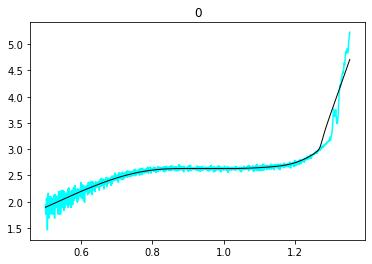

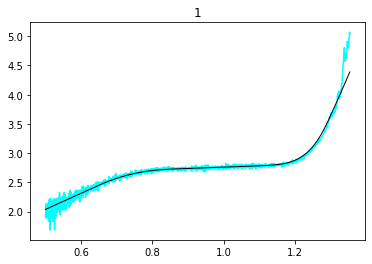

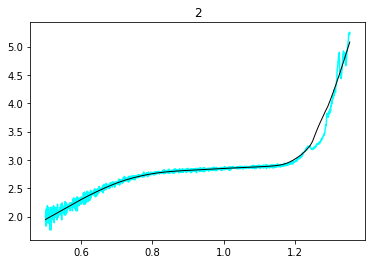

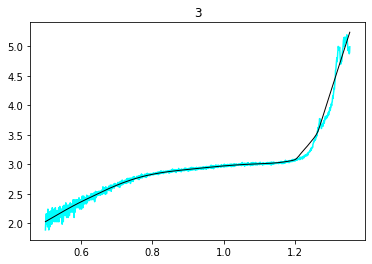

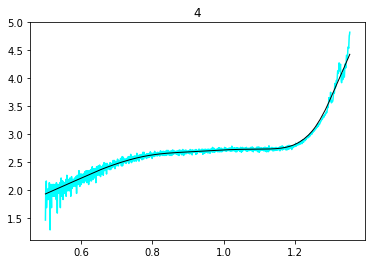

...

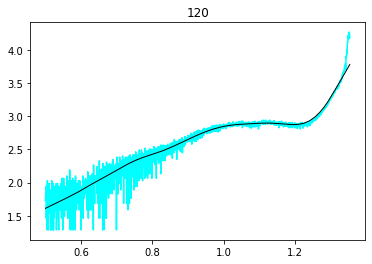

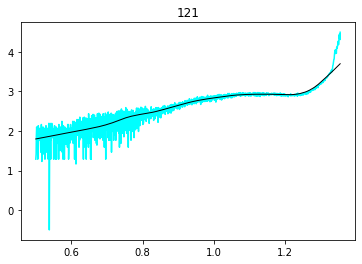

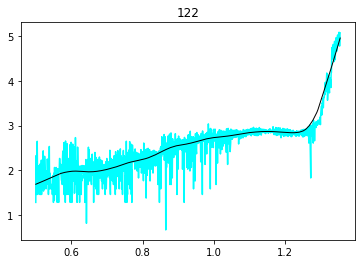

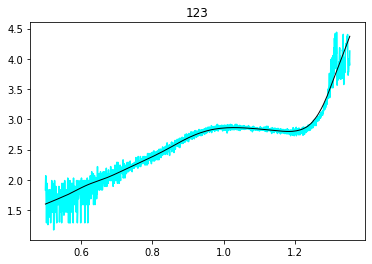

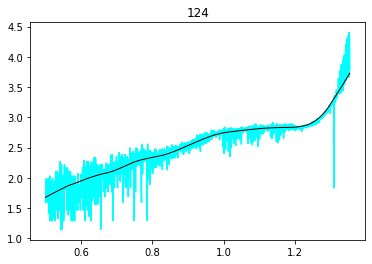

In [18]:
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  df_log.columns
for index, column in enumerate(column_names):
    fig, ax = plt.subplots() 
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(df_log[column],E,frac= 0.15,return_sorted=False)

    ax.plot(E , df_log[column], color = "cyan")
    ax.plot(E , ylow, linewidth = 1, color = "black")
    ax.set_title(column)

### storing the smoothed log(j) in dfs

In [353]:
df_ylow_log = df_log.copy()

column_names =  df_log.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(df_log[column],E,frac= 0.2,return_sorted=False) 
    df_ylow_log[column]=ylow
    
df_ylow_log

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,120,121,122,123,124
0,1.899930,2.039437,1.950695,2.039593,1.938453,1.987627,1.981383,1.971519,2.168435,2.192862,...,1.753743,1.830546,1.762018,1.775336,1.578530,1.610825,1.799374,1.738224,1.579223,1.693332
1,1.902665,2.041942,1.953906,2.042619,1.940964,1.990168,1.983920,1.974259,2.170883,2.195178,...,1.755976,1.832284,1.763826,1.777110,1.580596,1.613416,1.801009,1.740450,1.581846,1.695815
2,1.904488,2.043612,1.956047,2.044635,1.942638,1.991861,1.985611,1.976085,2.172516,2.196722,...,1.757464,1.833443,1.765031,1.778292,1.581974,1.615144,1.802100,1.741933,1.583594,1.697468
3,1.907223,2.046117,1.959258,2.047659,1.945148,1.994400,1.988147,1.978825,2.174964,2.199039,...,1.759696,1.835183,1.766839,1.780067,1.584041,1.617735,1.803736,1.744156,1.586219,1.699945
4,1.909046,2.047787,1.961398,2.049675,1.946822,1.996093,1.989838,1.980651,2.176596,2.200584,...,1.761183,1.836344,1.768044,1.781250,1.585420,1.619463,1.804826,1.745637,1.587969,1.701595
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,4.035012,4.181051,4.798690,5.039649,4.228800,3.979194,4.388930,4.396545,4.379136,5.125201,...,3.717278,4.124341,3.721901,3.725082,3.616387,3.672158,3.545005,4.459933,4.085678,3.588159
1103,4.045189,4.191150,4.811147,5.053366,4.239751,3.986512,4.399518,4.405909,4.391689,5.139284,...,3.724085,4.134484,3.729135,3.731718,3.623099,3.679305,3.551005,4.476297,4.096429,3.595063
1104,4.051976,4.197888,4.819454,5.062518,4.247056,3.991393,4.406580,4.412152,4.400073,5.148674,...,3.728626,4.141252,3.733962,3.736148,3.627579,3.684075,3.555011,4.487228,4.103601,3.599672
1105,4.062159,4.207999,4.831915,5.076254,4.258018,3.998717,4.417175,4.421516,4.412669,5.162759,...,3.735440,4.151408,3.741208,3.742798,3.634306,3.691236,3.561027,4.503655,4.114365,3.606593


In [54]:
# further smoothing the log(j) curves for improved Epass estimation  
df_ylow07_log = df_log.copy()

column_names =  df_log.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow07 = lowess(df_log[column],E,frac= 0.7,return_sorted=False)
    df_ylow07_log[column]=ylow07
    
df_ylow07_log

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,120,121,122,123,124
0,2.058339,2.171720,2.112634,2.165937,2.050623,2.085864,2.073228,2.080317,2.259794,2.265274,...,1.732312,1.802878,1.707780,1.777098,1.569284,1.656775,1.789376,1.710346,1.579758,1.722668
1,2.059950,2.173317,2.114576,2.167941,2.052351,2.087641,2.075212,2.082345,2.261554,2.267176,...,1.734566,1.804829,1.710000,1.779193,1.571649,1.659065,1.791300,1.712027,1.582215,1.724528
2,2.061023,2.174380,2.115870,2.169276,2.053503,2.088825,2.076534,2.083696,2.262728,2.268443,...,1.736069,1.806130,1.711480,1.780590,1.573226,1.660591,1.792583,1.713149,1.583853,1.725767
3,2.062633,2.175975,2.117811,2.171278,2.055230,2.090600,2.078516,2.085723,2.264487,2.270344,...,1.738324,1.808081,1.713701,1.782685,1.575591,1.662880,1.794508,1.714831,1.586310,1.727627
4,2.063705,2.177037,2.119104,2.172612,2.056381,2.091783,2.079837,2.087073,2.265660,2.271611,...,1.739827,1.809383,1.715181,1.784082,1.577168,1.664406,1.795791,1.715952,1.587948,1.728867
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,2.943902,3.104807,3.247070,3.506880,3.029421,3.331284,3.355696,3.223401,3.379248,3.421530,...,3.120509,3.150607,3.168635,3.157698,3.161447,3.133819,3.135900,3.064256,2.970611,3.091390
1103,2.944914,3.105913,3.248327,3.508565,3.030441,3.332818,3.356957,3.224180,3.380414,3.422607,...,3.121453,3.151671,3.169674,3.158736,3.162541,3.134788,3.136802,3.065217,2.971111,3.092516
1104,2.945589,3.106651,3.249166,3.509688,3.031121,3.333842,3.357798,3.224699,3.381191,3.423326,...,3.122083,3.152380,3.170367,3.159429,3.163271,3.135435,3.137403,3.065858,2.971445,3.093266
1105,2.946602,3.107758,3.250425,3.511375,3.032142,3.335378,3.359060,3.225478,3.382359,3.424405,...,3.123029,3.153445,3.171407,3.160468,3.164366,3.136406,3.138305,3.066819,2.971945,3.094393


# Epit estimation by rule-based linear regression

## definition of classes of log(j) Vs E curves based on their qualitative degree of similarity 

### providing initial guesses for the Epit intervals and the Epass values (for improved accuracy of estimation)

#### optimized combination for the general class
Epit interval=[0.9,1.2]

Epass=0.7 

In [14]:
Epit_interval_lower = float(input(r"Enter a guess value (V) for the lower limit of the Epit interval: ")) 
Epit_interval_upper = float(input(r"Enter a guess value (V) for the upper limit of the Epit interval: ")) 
Epass_estimated = float(input(r"Enter a guess value (V) for Epass: ")) 
interval_lower_i=E[E>Epit_interval_lower].dropna().index[0]
interval_upper_i=E[E<Epit_interval_upper].dropna().index[-1]
Epass_estimated_i=E[E<Epass_estimated].dropna().index[-1]
print("Epit guessed interval: "+str(round(E[interval_upper_i]-E[interval_lower_i],3))+" V")
print("Epass estimated: "+str(round(E[Epass_estimated_i],3))+" V")

Enter a guess value (V) for the lower limit of the Epit interval: 0.9
Enter a guess value (V) for the upper limit of the Epit interval: 1.2
Enter a guess value (V) for Epass: 0.7
Epit guessed interval: 0.299 V
Epass estimated: 0.7 V


In [15]:
# class1 and class2: not distinguished by the underlying electrochemical behaviour, but the different curves' shapes require different input intervals for improved computation
class1=[16,63] 
class2=[15,17,19,21,24,47,48,51,56,57,58,59,60] 

#### optimized combination for class1
Epit interval=[1.09,1.1]

Epass=1.08 

In [17]:
Epit_interval_lower1 = float(input(r"Enter a guess value (V) for the lower limit of the Epit interval: ")) 
Epit_interval_upper1 = float(input(r"Enter a guess value (V) for the upper limit of the Epit interval: ")) 
Epass_estimated1= float(input(r"Enter a guess value (V) for Epass: ")) 
interval_lower_i1=E[E>Epit_interval_lower1].dropna().index[0]
interval_upper_i1=E[E<Epit_interval_upper1].dropna().index[-1]
Epass_estimated_i1=E[E<Epass_estimated1].dropna().index[-1]
print("Epit guessed interval: "+str(round(E[interval_upper_i1]-E[interval_lower_i1],3))+" V")
print("Epass estimated: "+str(round(E[Epass_estimated_i1],3))+" V")

Enter a guess value (V) for the lower limit of the Epit interval: 1.09
Enter a guess value (V) for the upper limit of the Epit interval: 1.1
Enter a guess value (V) for Epass: 1.08
Epit guessed interval: 0.009 V
Epass estimated: 1.079 V


#### optimized combination for class2
Epit interval=[0.94,0.95]

Epass=0.93 

In [18]:
Epit_interval_lower2 = float(input(r"Enter a guess value (V) for the lower limit of the Epit interval: ")) 
Epit_interval_upper2 = float(input(r"Enter a guess value (V) for the upper limit of the Epit interval: "))
Epass_estimated2= float(input(r"Enter a guess value (V) for Epass: ")) 
interval_lower_i2=E[E>Epit_interval_lower2].dropna().index[0]
interval_upper_i2=E[E<Epit_interval_upper2].dropna().index[-1]
Epass_estimated_i2=E[E<Epass_estimated2].dropna().index[-1]
print("Epit guessed interval: "+str(round(E[interval_upper_i2]-E[interval_lower_i2],3))+" V")
print("Epass estimated: "+str(round(E[Epass_estimated_i2],3))+" V")

Enter a guess value (V) for the lower limit of the Epit interval: 0.94
Enter a guess value (V) for the upper limit of the Epit interval: 0.95
Enter a guess value (V) for Epass: 0.93
Epit guessed interval: 0.009 V
Epass estimated: 0.93 V


In [19]:
no_passive_class=[13,14,18] # --> out of ML scope # by default, Epit = 0.5 V

## plotting the Epit (E and log(j) pair values) estimated by linear regression

13 no passivity
14 no passivity


C:\Users\lbertolu\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:582: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


18 no passivity


C:\Users\lbertolu\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:582: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


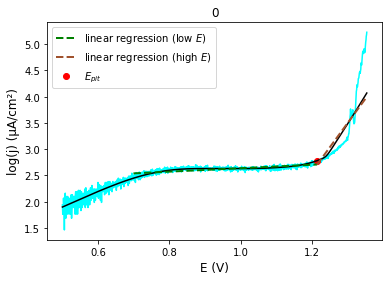

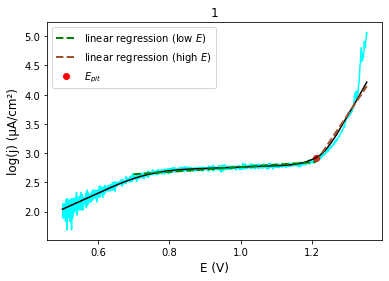

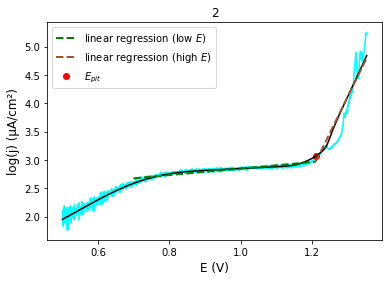

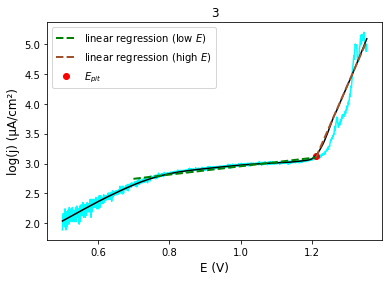

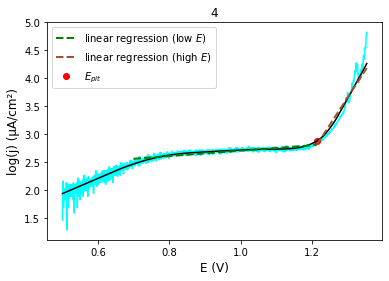

...

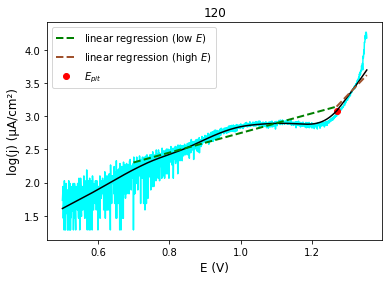

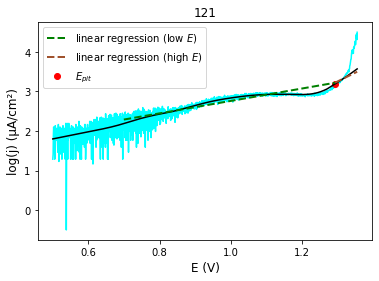

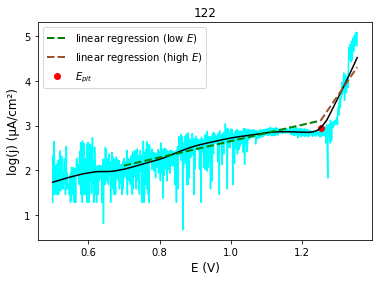

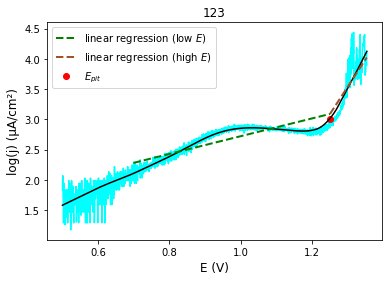

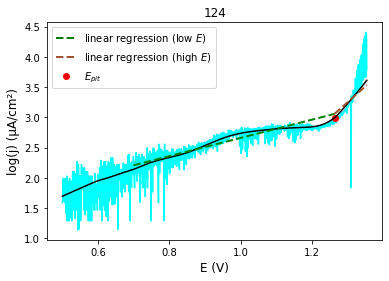

In [106]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  df_ylow_log.columns

#collect all of the slopes and intercepts for the two parts
Epit_E, Epit_j = [],[]

#initialise the two models for part 1 and part 2
model1 = LinearRegression()
model2 = LinearRegression()

for index, column in enumerate(column_names):
    fig, ax = plt.subplots() 
    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)
    ax.set_title(column)

    # Initialize the r2 values
    r2_final1, r2_final2 = 0, 0
    
    if column not in no_passive_class:
        
#State which end values for the first part and begin values for the second part should be checked to find the best linear regression
        if column in class1:
            limits_pit = range(interval_lower_i1,interval_upper_i1+1,1) # row indexes
            pass
        elif column in class2:
            limits_pit = range(interval_lower_i2,interval_upper_i2+1,1) # row indexes 
            pass
        else:
            limits_pit = range(interval_lower_i,interval_upper_i+1,1) # row indexes  
            pass

        for limit in limits_pit:
        
        #split the data into the first part and second part
            if column in class1:
                dfE_2 =  E.iloc[limit:limits_pit[-1]+1]
                dfj_2 =  df_ylow_log.iloc[limit:limits_pit[-1]+1]
                pass
            else:
                dfE_2 =  E.iloc[limit:]
                dfj_2 =  df_ylow_log.iloc[limit:]  
                pass
            dfE_1 =  E.iloc[Epass_estimated_i:limit+1]
            dfj_1 =  df_ylow_log.iloc[Epass_estimated_i:limit+1]
            
            X1,X2 = dfE_1.values.reshape(-1, 1),dfE_2.values.reshape(-1, 1)
            y1,y2 = dfj_1[column].values.reshape(-1, 1),dfj_2[column].values.reshape(-1, 1)

            # Fit models
            regr1, regr2 = model1.fit(X1, y1), model2.fit(X2, y2)
    
            # Evaluate models
            r2_score1, r2_score2 = r2_score(y1, regr1.predict(X1)), r2_score(y2, regr2.predict(X2))

            # Store best models
            if r2_score1 > r2_final1:
                r2_final1, regr_final1 = r2_score1, regr1
            if r2_score2 > r2_final2:
                r2_final2, regr_final2 = r2_score2, regr2

        # Determine intersection
        a1, a2 = regr_final1.coef_[0], regr_final2.coef_[0]
        b1, b2 = regr_final1.intercept_, regr_final2.intercept_

        x_intersect = np.around((b1-b2)/(a2-a1),3) 
        E_tempo=E.round(3)
        try:
            xi=E_tempo[E_tempo<=x_intersect.item()].index[-1]
        except:
            xi=E_tempo[E_tempo>=x_intersect.item()].index[0]

        try:
            ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
            # plot the best-fit lines up to the intersection
            x1_reg,x2_reg  = E.iloc[Epass_estimated_i:xi+1],E.iloc[xi:]
            y1_reg,y2_reg  = x1_reg * a1 + b1,x2_reg * a2 + b2

            ax.plot(x1_reg, y1_reg, linewidth = 2, color = 'green', linestyle = 'dashed',label="linear regression (low $E$)")
            ax.plot(x2_reg, y2_reg, linewidth = 2, color = 'sienna', linestyle = 'dashed',label="linear regression (high $E$)")
            ax.scatter(E.iloc[xi],df_ylow_log[column].iloc[xi],color="red",label="$E_{pit}$")
            ax.legend()
            
            ax.set_ylabel("log(j) (µA/cm²)")
            ax.set_xlabel("E (V)")
            ax.xaxis.label.set_size(12)
            ax.yaxis.label.set_size(12)
    
            Epit_E.append(E.iloc[xi])
            Epit_j.append(df_ylow_log[column].iloc[xi])

        except: 
            print(column)
            Epit_E.append(np.nan)
            Epit_j.append(np.nan)

    else: 
        print(str(column)+" no passivity")
        ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
        ax.scatter(E.iloc[0],df_ylow_log[column].iloc[0],color="red",label="$E_{pit}$")
        ax.legend()
        Epit_E.append(E.iloc[0])
        Epit_j.append(df_ylow_log[column].iloc[0])

In [21]:
# unsatisfactory Epit estimates from the LR-based algorithm --> ML test set
# list of maps (data samples) with unsatisfactory estimates 
maps_test_list=[24, 56, 65, 70, 89, 92, 103, 105, 115, 117, 119, 123]

# Machine Learning

### data pre-processing

To focus specifically on the relevant regions of the PP curves that encompass the pitting descriptors, the log(j) Vs E (smoothed) curves were partitioned through a data slicing procedure. The sliced curves presented 500 data points (0.288 V in potential range), sufficiently capturing the regions related to Epit with high security margins. 

In [362]:
E_sliced=E.iloc[550:1050] 
j_sliced=df_log.iloc[550:1050,:]
j_sliced_smooth=df_ylow_log.iloc[550:1050,:]

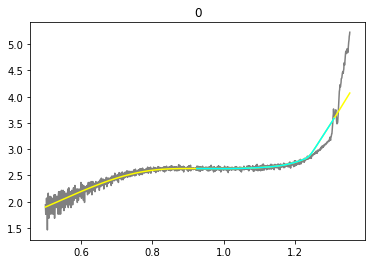

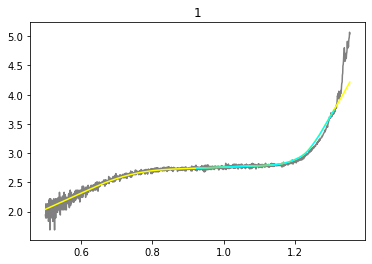

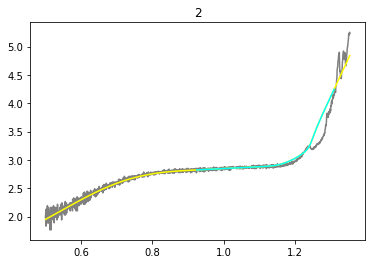

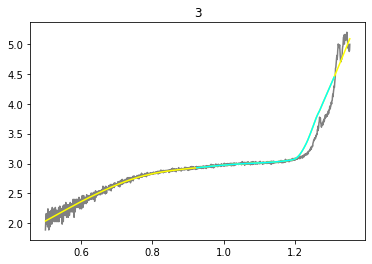

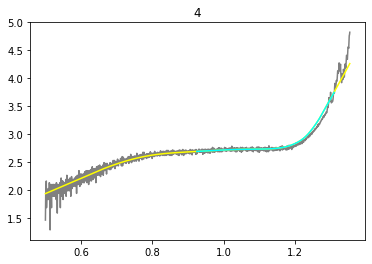

...

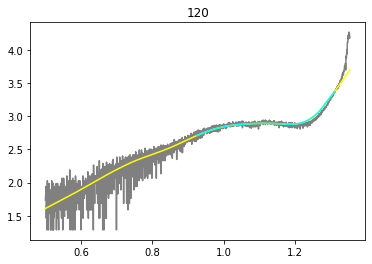

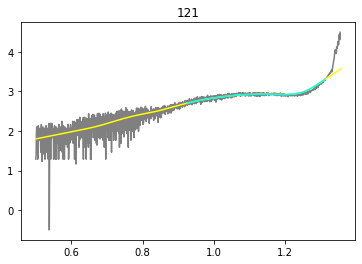

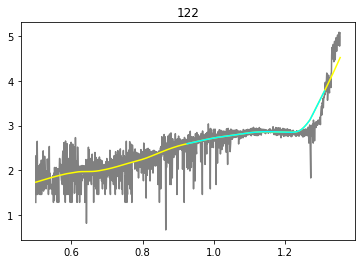

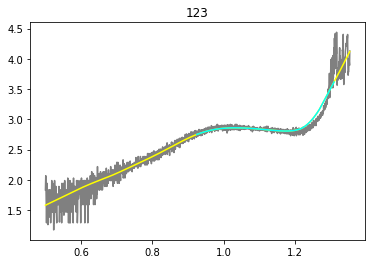

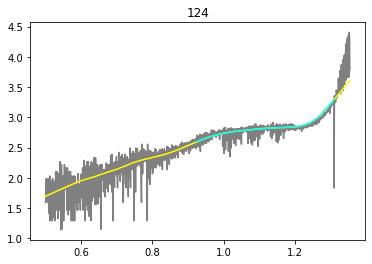

In [41]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  j_sliced.columns 

for index, column in enumerate(column_names):
    if column not in no_passive_class:
    
        fig, ax = plt.subplots() 

        ax.plot(E , df_log[column], color = "grey",zorder=1)
        ax.plot(E , df_ylow_log[column], color = "yellow",zorder=2)
        ax.plot(E_sliced , j_sliced_smooth[column], color = "cyan",zorder=3)
        ax.set_title(column)

### feature engineering 

In [363]:
# defining the log(j) values from the sliced curves as data features (columns of the df)
j_transp=j_sliced_smooth.T
j_transp.index.name="Maps"
# selecting the corresponding E (V) stamps of the data features
E_transp=E_sliced.T
E_transp.index.name="Maps"

# drop no_passive_class from features df
j_transp = j_transp.drop(no_passive_class, axis=0) 
j_transp

,550,551,552,553,554,555,556,557,558,559,...,1040,1041,1042,1043,1044,1045,1046,1047,1048,1049
Maps,,,,,,,,,,,,,,,,,,,,,
0,2.631787,2.631763,2.631726,2.631702,2.631666,2.631641,2.631604,2.631580,2.631543,2.631506,...,3.514679,3.521170,3.530918,3.537424,3.547194,3.553714,3.563509,3.570044,3.579860,3.586410
1,2.742484,2.742624,2.742835,2.742975,2.743187,2.743329,2.743543,2.743686,2.743901,2.744117,...,3.668719,3.675109,3.684701,3.691101,3.700708,3.707118,3.716744,3.723165,3.732806,3.739238
2,2.823752,2.823955,2.824259,2.824462,2.824767,2.824970,2.825275,2.825478,2.825783,2.826088,...,4.154137,4.162370,4.174719,4.182952,4.195301,4.203534,4.215887,4.224120,4.236473,4.244708
3,2.930254,2.930632,2.931198,2.931575,2.932140,2.932517,2.933081,2.933456,2.934019,2.934581,...,4.349512,4.358009,4.370772,4.379295,4.392097,4.400644,4.413487,4.422060,4.434940,4.443538
4,2.693079,2.693300,2.693632,2.693853,2.694186,2.694408,2.694742,2.694965,2.695299,2.695634,...,3.671908,3.678878,3.689339,3.696319,3.706796,3.713785,3.724279,3.731279,3.741788,3.748799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,2.709021,2.710427,2.712527,2.713923,2.716009,2.717394,2.719465,2.720840,2.722895,2.724941,...,3.315924,3.320297,3.326864,3.331249,3.337833,3.342229,3.348832,3.353240,3.359860,3.364279
121,2.702839,2.704210,2.706260,2.707620,2.709652,2.711001,2.713014,2.714350,2.716344,2.718326,...,3.249788,3.253347,3.258695,3.262267,3.267635,3.271220,3.276609,3.280208,3.285617,3.289230
122,2.595392,2.596498,2.598155,2.599258,2.600912,2.602014,2.603667,2.604769,2.606421,2.608073,...,3.661094,3.670813,3.685404,3.695143,3.709767,3.719527,3.734188,3.743972,3.758670,3.768480


#### data targeting and data splitting

In [364]:
# defining and selecting the data target (Epit (V))
labels = pd.DataFrame({"Epit_E":Epit_E})
labels.index.name="Maps"
labels = labels.drop(no_passive_class, axis=0)  # drop no_passive_class from target df

# splitting the data into training and test sets
test_labels=labels.loc[maps_test_list] # test set = unsatisfactory Epit estimates 
j_test=j_transp.loc[maps_test_list]
j_train=j_transp.drop(maps_test_list, axis=0)
train_labels=labels.drop(maps_test_list, axis=0)
train_labels

,Epit_E
Maps,
0,1.214026
1,1.210975
2,1.210975
3,1.210975
4,1.213416
...,...
118,1.244850
120,1.268960
121,1.291238


#### Data Scaling

Given that machine learning algorithms can be sensitive to feature magnitude, we standardize our features to have zero mean and unit variance. This is done using the `StandardScaler()` from `scikit-learn`.

In [365]:
scale_pipe = Pipeline([
    ('scaler', StandardScaler())    
])

j_transp_scaled = scale_pipe.fit_transform(j_transp) 

j_transp_scaled = pd.DataFrame(j_transp_scaled)
j_transp_scaled.index=j_transp.index # getting correct maps (pd.DataFrame reset index)
j_transp_scaled.index.name="Maps"

# splitting the scaled data into training and test sets
j_train_scaled = j_transp_scaled.drop(maps_test_list, axis=0) 
j_test_scaled = j_transp_scaled.loc[maps_test_list,:] 
j_test_scaled
# PS: note that target variables (`labels`) are not scaled since they represent actual output values we aim to predict

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
Maps,,,,,,,,,,,,,,,,,,,,,
24,-0.361869,-0.363366,-0.365620,-0.367127,-0.369393,-0.370906,-0.373178,-0.374692,-0.376962,-0.379229,...,0.512491,0.506059,0.496400,0.489954,0.480278,0.473822,0.464129,0.457665,0.447964,0.441495
56,-1.555246,-1.548039,-1.537128,-1.529786,-1.518675,-1.511201,-1.499892,-1.492289,-1.480788,-1.469175,...,-0.808674,-0.815407,-0.825455,-0.832119,-0.842063,-0.848658,-0.858499,-0.865024,-0.874760,-0.881214
65,0.028350,0.030187,0.032918,0.034723,0.037403,0.039173,0.041802,0.043537,0.046114,0.048658,...,-0.693246,-0.694111,-0.695383,-0.696215,-0.697439,-0.698240,-0.699417,-0.700186,-0.701317,-0.702055
70,0.336678,0.338071,0.340141,0.341509,0.343542,0.344884,0.346876,0.348191,0.350144,0.352072,...,-0.348152,-0.349535,-0.351588,-0.352942,-0.354949,-0.356273,-0.358236,-0.359528,-0.361444,-0.362706
89,-0.201222,-0.199348,-0.196557,-0.194711,-0.191963,-0.190145,-0.187441,-0.185654,-0.182995,-0.180364,...,-0.720449,-0.720536,-0.720643,-0.720699,-0.720762,-0.720790,-0.720810,-0.720810,-0.720790,-0.720764
92,0.280690,0.281156,0.281833,0.282270,0.282904,0.283312,0.283903,0.284282,0.284829,0.285351,...,-0.582942,-0.584112,-0.585843,-0.586982,-0.588668,-0.589777,-0.591419,-0.592499,-0.594097,-0.595148
103,0.387954,0.388451,0.389180,0.389653,0.390345,0.390794,0.391450,0.391874,0.392493,0.393090,...,-0.639790,-0.642289,-0.646009,-0.648472,-0.652140,-0.654567,-0.658184,-0.660577,-0.664142,-0.666501
105,0.265984,0.268480,0.272214,0.274697,0.278410,0.280879,0.284571,0.287024,0.290692,0.294344,...,-0.559527,-0.561364,-0.564091,-0.565890,-0.568560,-0.570320,-0.572932,-0.574654,-0.577206,-0.578888
115,0.225693,0.226393,0.227425,0.228102,0.229099,0.229752,0.230715,0.231344,0.232271,0.233177,...,-0.667042,-0.669006,-0.671926,-0.673856,-0.676726,-0.678622,-0.681443,-0.683307,-0.686078,-0.687909


## Artificial neural networks

- [Neural networks for regresion with tensorflow](https://nyandwi.com/machine_learning_complete/26_neural_networks_for_regresion_with_tensorflow/)

### Epit model

#### selection of input features 
- [feature reduction](https://scikit-learn.org/stable/modules/feature_selection.html)

In [366]:
# reducing the complexity of the log(j) data by diminishing its dimensionality: selecting every 40th feature from the "j_transp_scaled" df
j_transp_scaled_red=j_transp_scaled.copy()
j_transp_scaled_red=j_transp_scaled_red[np.arange(0,j_transp_scaled.shape[1],40)]
j_transp_scaled_red

j_train_scaled_red=j_train_scaled.copy()
j_train_scaled_red=j_train_scaled_red[np.arange(0,j_train_scaled.shape[1],40)]
j_train_scaled_red

j_test_scaled_red=j_test_scaled.copy()
j_test_scaled_red=j_test_scaled_red[np.arange(0,j_test_scaled.shape[1],40)]
j_test_scaled_red

,0,40,80,120,160,200,240,280,320,360,400,440,480
Maps,,,,,,,,,,,,,
24,-0.361869,-0.432286,-0.558261,-0.850117,-1.148076,-1.272391,-1.003604,-0.407844,0.270776,0.847998,1.122636,0.924334,0.595471
56,-1.555246,-1.138771,-0.686042,-0.286590,-0.003308,0.171922,0.258913,0.330398,0.349760,0.274496,0.052293,-0.329144,-0.718708
65,0.028350,0.103023,0.136937,0.128800,0.088585,0.025870,-0.059600,-0.160846,-0.271034,-0.370232,-0.460421,-0.597530,-0.680745
70,0.336678,0.393225,0.422699,0.423795,0.400010,0.357194,0.288777,0.200107,0.101185,0.012835,-0.102678,-0.238591,-0.329156
89,-0.201222,-0.122862,-0.081957,-0.081584,-0.113235,-0.167951,-0.245157,-0.339186,-0.440809,-0.526906,-0.587394,-0.675901,-0.718125
92,0.280690,0.290367,0.275771,0.239285,0.187231,0.126055,0.048655,-0.044181,-0.148989,-0.240168,-0.322508,-0.468453,-0.566539
103,0.387954,0.401413,0.394285,0.367155,0.324269,0.269809,0.194764,0.101127,-0.011504,-0.129667,-0.257311,-0.445291,-0.605986
105,0.265984,0.382382,0.470511,0.518670,0.528528,0.503795,0.437190,0.333945,0.192121,0.022603,-0.181061,-0.401305,-0.534313
115,0.225693,0.249258,0.250594,0.228589,0.186685,0.130683,0.053467,-0.040850,-0.150996,-0.241406,-0.330205,-0.502563,-0.640241


#### visualising the non-scaled / scaled features (sliced log(j)) and the 13 selected input features

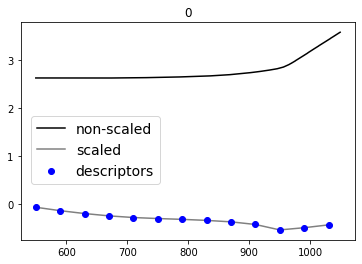

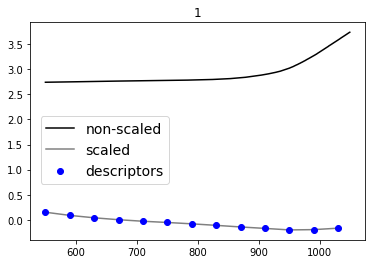

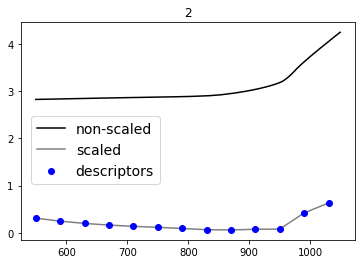

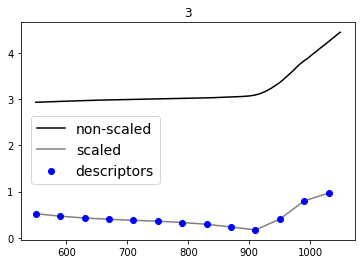

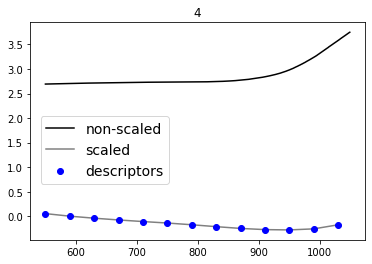

...

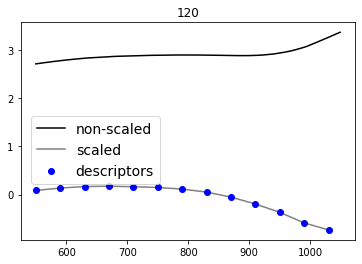

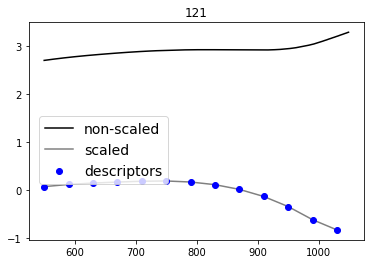

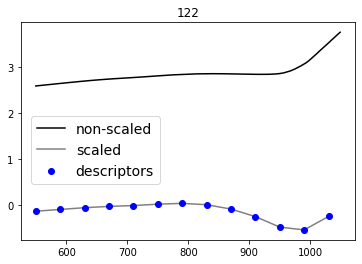

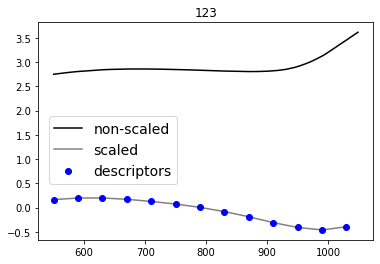

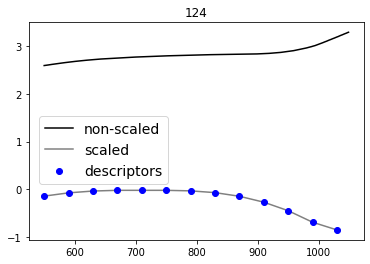

In [66]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

index_names =  j_transp_scaled_red.index 

for index in index_names:
    fig, ax = plt.subplots() 
    
    ax.plot(j_transp.loc[index,:], color = "k",zorder=1,label="non-scaled")
    ax.plot(j_transp_scaled_red.columns+j_transp.columns[0],j_transp_scaled_red.loc[index,:], color = "grey",zorder=1,label="scaled")
    ax.scatter(j_transp_scaled_red.loc[index,:].index+j_transp.columns[0],j_transp_scaled_red.loc[index,:],c="b",zorder=2,label="descriptors")
    ax.set_title(index)
    ax.legend(loc="upper left",bbox_to_anchor=(0.01,0.6),prop={'size': 14})

#### Setting Up Neural Network Parameters

Here, we configure our neural network's input shape based on the number of features in the dataset. Additionally, we define training parameters:

- **input_shape**: Represents the number of features and must be defined as a tuple for compatibility with the neural network framework.
- **epochs**: Number of passes through the entire training dataset.
- **batches**: Size of data chunks processed by the neural network during each iteration. 

In our setup, we are using a batch size equal to the total number of training samples. This method, often referred to as "batch gradient descent" or "full-batch" training, has its merits:

- **Optimal Gradient Estimates**: Using the entire dataset provides a precise gradient computation, promoting stable weight updates and potentially faster convergence.
- **Deterministic Updates**: Full-batch training ensures consistent weight updates across iterations, offering predictability and easier debugging.

In [367]:
input_shape = j_transp_scaled_red.shape[1] 
input_shape=(input_shape,) 
input_shape 

epochs=200

batches=int(j_train_scaled_red.shape[0])
batches 

110

#### Cross-validation for Neural Network Training

To achieve a more robust evaluation during initial training, we utilize cross-validation. Specifically, we've chosen K-fold cross-validation, which partitions our dataset into \( K \) different folds and trains/tests the model \( K \) times, each time with a different fold as the test set.

Our neural network architecture is designed for a regression problem:

- **Input Layer**: Matches the number of features in our dataset. Uses the ReLU activation function.
- **Hidden Layer 1**: Contains 12 nodes and uses ReLU.
- **Hidden Layer 2**: Contains 11 nodes and uses ReLU.
- **Output Layer**: A single node without any activation function, suitable for regression tasks, providing continuous output values.

Note: Neural networks with two hidden layers can theoretically model any function shape, eliminating the need for additional layers in many cases

- [Evaluate Performance of Deep Learning Models with Keras](https://machinelearningmastery.com/evaluate-performance-deep-learning-models-keras/)

In [325]:
#### Neural Network Training with Cross-validation:

def cross_validate(X, y, K=10, **kwargs):
    scores = []
    histories = []
    for train, test in KFold(n_splits=K, shuffle=True).split(X,y): 
        # compiling the model
        model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])
        histories.append(model.fit(X.iloc[train], y.iloc[train], validation_data=(X.iloc[test],y.iloc[test]), batch_size=batches, epochs=epochs))
        # using "model.fit" in the same code block (for restarting from the initial epoch each time)
        scores.append(model.evaluate(X.iloc[test], y.iloc[test], verbose=0))
        
        print("\nval_loss:", round(np.asarray(scores)[-1,0], 4))
        print("val_R2:", round(np.asarray(scores)[-1,1], 4), "\n")
        
    print(scores)
    print("\nmean R2:", round(np.asarray(scores)[:,1].mean(), 4))
    
    return scores, histories

# Model Definition
model = keras.models.Sequential([
    keras.layers.Dense(input_shape[0], activation='relu', input_shape=input_shape),
    keras.layers.Dense(12, activation='relu'),
    keras.layers.Dense(11, activation='relu'),
    keras.layers.Dense(1)         
])

scores, histories = cross_validate(j_train_scaled_red, train_labels, K=20)

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 4.9061 - coeff_determination: -701.1052 - val_loss: 10.7915 - val_coeff_determination: -930.9225
Epoch 2/200
1/1 [==============================] - 0s 50ms/step - loss: 4.7235 - coeff_determination: -674.9688 - val_loss: 10.2572 - val_coeff_determination: -884.7821
Epoch 3/200
1/1 [==============================] - 0s 40ms/step - loss: 4.5487 - coeff_determination: -649.9476 - val_loss: 9.8104 - val_coeff_determination: -846.1956
Epoch 4/200
1/1 [==============================] - 0s 61ms/step - loss: 4.3837 - coeff_determination: -626.3366 - val_loss: 9.4116 - val_coeff_determination: -811.7580
Epoch 5/200
1/1 [==============================] - 0s 62ms/step - loss: 4.2301 - coeff_determination: -604.3533 - val_loss: 9.0283 - val_coeff_determination: -778.6532
Epoch 6/200
1/1 [==============================] - 0s 42ms/step - loss: 4.0834 - coeff_determination: -583.3660 - val_loss: 8.6570 - val_coeff_determination: -7

#### Model Training Histories

The below visualizations represent the history of our model training (learning curves) through 20-fold cross-validation. The `loss` ('mean_squared_error') and `R-squared` metrics have been monitored for both training and validation sets.

- **Loss:** This metric represents how well our predictions match the actual values (the lower the loss, the better).
    - Blue Line: Training Loss
    - Orange Line: Validation Loss

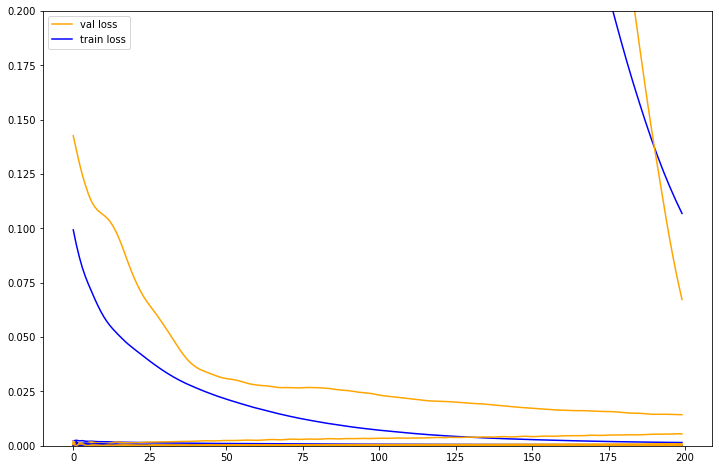

In [326]:
fig, ax = plt.subplots(figsize=(12,8)) 
for h in histories:
    ax.plot(h.history["loss"],c="b")
    ax.plot(h.history["val_loss"],c="orange")

ax.plot(0,0,c="orange",label="val loss") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train loss") # plot for the sake of the legend label
ax.set_ylim(0,0.2)
ax.legend()

- **R-squared:** the coefficient of determination measures of how well the model's predictions match the actual values. A value of 1 indicates perfect predictions.
    - Blue Line: Training R-squared
    - Orange Line: Validation R-squared

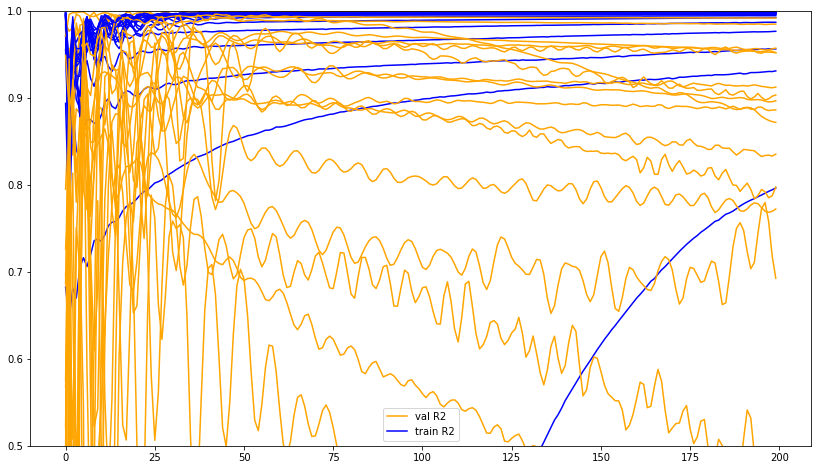

In [327]:
fig, ax = plt.subplots(figsize=(14,8)) 
for h in histories:
    ax.plot(h.history["coeff_determination"],c="b")
    ax.plot(h.history["val_coeff_determination"],c="orange")

ax.plot(0,0,c="orange",label="val R2") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train R2") # plot for the sake of the legend label
ax.set_ylim(0.5,1)
ax.legend()

In [328]:
# Model Architecture
model.summary()

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_124 (Dense)           (None, 13)                182       
                                                                 
 dense_125 (Dense)           (None, 12)                168       
                                                                 
 dense_126 (Dense)           (None, 11)                143       
                                                                 
 dense_127 (Dense)           (None, 1)                 12        
                                                                 
Total params: 505
Trainable params: 505
Non-trainable params: 0
_________________________________________________________________


#### Re-Training with Model Pruning

1. **Pruning Parameters Setup:** We define a schedule starting from 0% sparsity, aiming to reach 90% by the end of the training (using TensorFlow's Model Optimization Toolkit).
2. **Model Definition:** A neural network is defined again (resetting the model), with the same architecture as before. This model will be subjected to pruning. The number of epochs is expected to increase in the prunned model. We initially attempt increasing by "n": "epochs"=epochs*n
3. **Compile the Model:** The optimizer, loss function, and metrics are specified.
4. **Model Training:** The model is trained with a training split, incorporating the pruning callback. Despite using KFold earlier for validation, here we employ a `validation_split` for simplicity in the training phase.

- [Model Pruning with TensorFlow](https://towardsdatascience.com/model-pruning-in-deep-neural-networks-using-the-tensorflow-api-7cf52bdd32)

In [329]:
n=40 # epochs multiplier

In [330]:
import tensorflow_model_optimization as tfmot
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs*n
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [331]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'), 
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=0.001) # default learning rate

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs*n,validation_split=0.1,callbacks=pruning_callback)

Epoch 1/8000
1/1 [==============================] - 1s 1s/step - loss: 1.2841 - coeff_determination: -164.7771 - val_loss: 1.5597 - val_coeff_determination: -6495.7275
Epoch 2/8000
1/1 [==============================] - 0s 38ms/step - loss: 1.2556 - coeff_determination: -161.0989 - val_loss: 1.5355 - val_coeff_determination: -6394.9126
Epoch 3/8000
1/1 [==============================] - 0s 39ms/step - loss: 1.2284 - coeff_determination: -157.5821 - val_loss: 1.5115 - val_coeff_determination: -6294.8750
Epoch 4/8000
1/1 [==============================] - 0s 42ms/step - loss: 1.2020 - coeff_determination: -154.1716 - val_loss: 1.4876 - val_coeff_determination: -6195.4858
Epoch 5/8000
1/1 [==============================] - 0s 48ms/step - loss: 1.1769 - coeff_determination: -150.9308 - val_loss: 1.4644 - val_coeff_determination: -6098.9590
Epoch 6/8000
1/1 [==============================] - 0s 28ms/step - loss: 1.1530 - coeff_determination: -147.8475 - val_loss: 1.4421 - val_coeff_determin

#### Full Dataset Training with Model Pruning

The model is trained on the entire dataset without any validation split. The focus here is to prune the model with a significant number of epochs.

**Optimizer Setup:** 
1. decreasing the learning rate of the Adam optimizer
2. fine-tuning the number of epochs of the pruned model

In [332]:
epochs_pruned=7000 

lr=0.00001 # decreasing the learning rate

In [333]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs_pruned
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [334]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'),
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=lr)

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs_pruned,callbacks=pruning_callback)

Epoch 1/7000
1/1 [==============================] - 1s 645ms/step - loss: 1.1542 - coeff_determination: -158.4293
Epoch 2/7000
1/1 [==============================] - 0s 8ms/step - loss: 1.1238 - coeff_determination: -154.2320
Epoch 3/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0947 - coeff_determination: -150.2028
Epoch 4/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0667 - coeff_determination: -146.3358
Epoch 5/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0399 - coeff_determination: -142.6327
Epoch 6/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0141 - coeff_determination: -139.0705
Epoch 7/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9892 - coeff_determination: -135.6297
Epoch 8/7000
1/1 [==============================] - 0s 0s/step - loss: 0.9653 - coeff_determination: -132.3378
Epoch 9/7000
1/1 [==============================] - 0s 15ms/step - loss: 0.9426 - coeff_determination: 

(-1e-07, 0.0004)

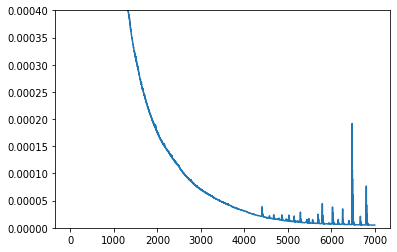

In [335]:
# loss
fig, ax = plt.subplots() 
ax.plot(history.history["loss"],label="loss")
ax.set_ylim(-0.0000001,0.0004)

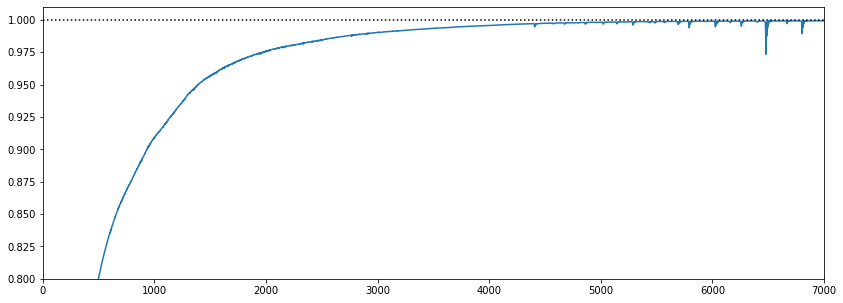

In [336]:
# R²
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"],label="R²")
ax.set_ylim(0.8,1.01)
ax.set_xlim(0,epochs_pruned)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

updating the number of epochs for the pruned model (for additional optimization)

In [375]:
epochs_pruned=6000 # decreasing the number of epochs 

lr=0.00001 

In [376]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled.shape[0] / batches).astype(np.int32) * epochs_pruned
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [377]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape[0], activation='relu',input_shape=input_shape), 
            keras.layers.Dense(12, activation='relu'), 
            keras.layers.Dense(11, activation='relu'),
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=lr)

model.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model.fit(j_train_scaled_red, train_labels,batch_size=batches,epochs=epochs_pruned,callbacks=pruning_callback)

Epoch 1/6000
1/1 [==============================] - 1s 792ms/step - loss: 1.3658 - coeff_determination: -229.8747
Epoch 2/6000
1/1 [==============================] - 0s 7ms/step - loss: 1.3302 - coeff_determination: -223.8450
Epoch 3/6000
1/1 [==============================] - 0s 6ms/step - loss: 1.2957 - coeff_determination: -218.0227
Epoch 4/6000
1/1 [==============================] - 0s 7ms/step - loss: 1.2622 - coeff_determination: -212.3658
Epoch 5/6000
1/1 [==============================] - 0s 7ms/step - loss: 1.2289 - coeff_determination: -206.7295
Epoch 6/6000
1/1 [==============================] - 0s 8ms/step - loss: 1.1964 - coeff_determination: -201.2282
Epoch 7/6000
1/1 [==============================] - 0s 9ms/step - loss: 1.1651 - coeff_determination: -195.9511
Epoch 8/6000
1/1 [==============================] - 0s 10ms/step - loss: 1.1354 - coeff_determination: -190.9191
Epoch 9/6000
1/1 [==============================] - 0s 9ms/step - loss: 1.1072 - coeff_determination:

(-1e-05, 0.001)

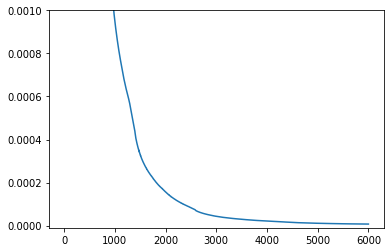

In [378]:
# loss
fig, ax = plt.subplots() 
ax.plot(history.history["loss"])
ax.set_ylim(-0.00001,0.001)

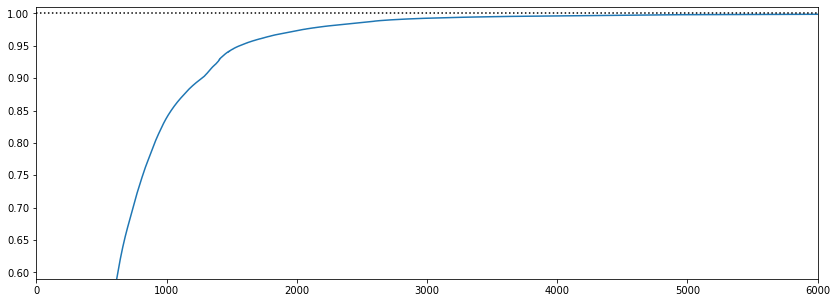

In [379]:
# R²
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"])
ax.set_ylim(0.59,1.01)
ax.set_xlim(0,epochs_pruned)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

#### deploying the trained model on the test set

In [380]:
predict_test=model.predict(j_test_scaled_red) 
predict_test

1/1 [==============================] - 0s 115ms/step


array([[1.2058002 ],
       [0.57006925],
       [1.2682415 ],
       [1.2526007 ],
       [1.2309484 ],
       [1.2629044 ],
       [1.264703  ],
       [1.2850307 ],
       [1.2656044 ],
       [1.2880938 ],
       [1.2793602 ],
       [1.2589219 ]], dtype=float32)

#### plotting the Epit estimates superimposed to the test data samples (row/smoothed log(j) Vs E curves)

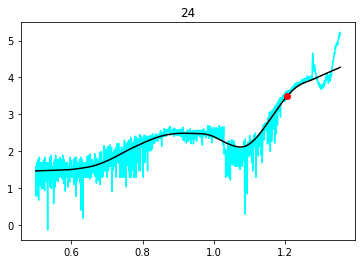

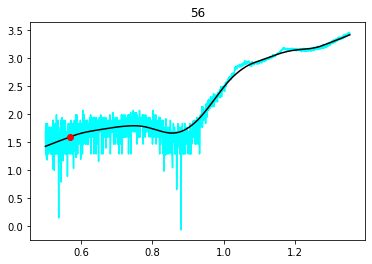

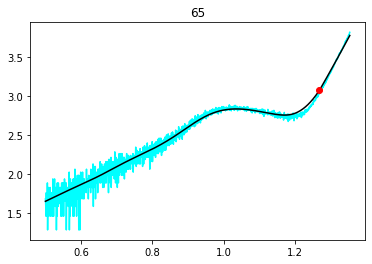

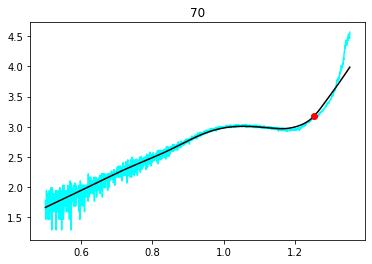

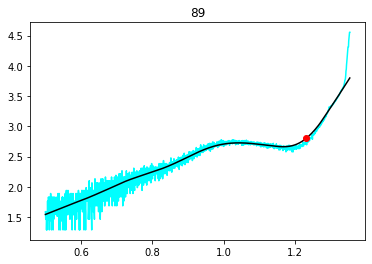

...

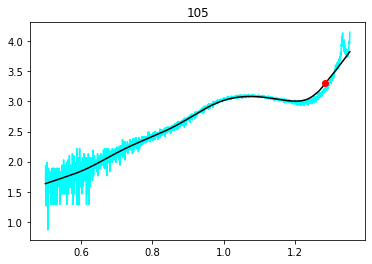

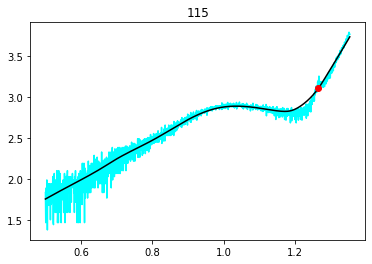

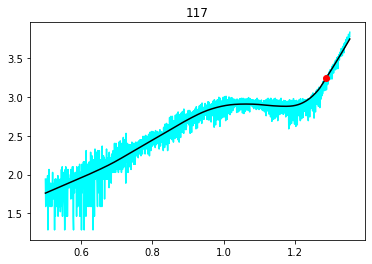

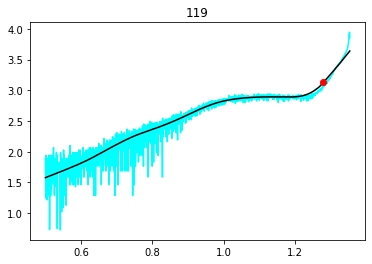

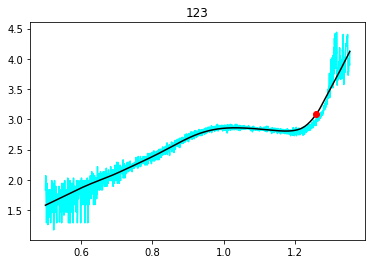

In [381]:
index_names =  j_test_scaled_red.index 

for index, column in enumerate(index_names):
    fig, ax = plt.subplots() 
    ax.set_title(column)    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)
    ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
    ax.scatter(predict_test[index][0], df_ylow_log[column][E>=predict_test[index][0]].iloc[0], color = "red",zorder=3)
# log(jpit) was calculated from the output Epit (log(j) is a function of E)

#### performance evaluation on training set

Note: we only dispose of the labels for the training set. The test set comprises the unsatisfactory estimates obtained with the rule-based LR (reason for leveraging ANN was precisely to improve the quality of these estimates)

4/4 [==============================] - 0s 4ms/step


Text(0.5, 1.0, 'Epit')

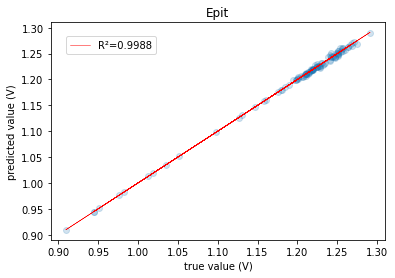

In [382]:
predict_train=model.predict(j_train_scaled_red)
R2=round(r2_score(train_labels, predict_train),4)

fig, ax = plt.subplots()

ax.scatter(train_labels,predict_train,alpha=0.2)
ax.set_ylabel("predicted value (V)")
ax.set_xlabel("true value (V)")

#obtain m (slope) and b (intercept) of linear regression line
x=train_labels["Epit_E"]
model_lin = np.polyfit(x,predict_train.flatten(),1)
ax.plot(x, model_lin[0]*x+model_lin[1],c="r",linewidth=0.5,label="R²="+str(R2))

fig.legend(loc="upper left", bbox_to_anchor=(0.15, 0.85))
ax.set_title('Epit')

### storing the Epit (x,y) values in a df

In [383]:
index_names =  j_transp_scaled.index 

predict_entire=model.predict(j_transp_scaled_red) # deploying the trained model on the entire (training + test) set

Epit_x, Epit_y = [],[]
for e,(index,column) in zip(predict_entire,enumerate(index_names)):
    Epit_x.append(e[0])
    Epit_y.append(df_ylow_log[column][E>=predict_entire[index][0]].iloc[0])
    
pit_log = pd.DataFrame({"Epit_x":Epit_x,"Epit_y":Epit_y})
pit_log.index=j_transp_scaled.index
pit_log.index.name="Maps"
pit_log

4/4 [==============================] - 0s 2ms/step


,Epit_x,Epit_y
Maps,,
0,1.212015,2.777569
1,1.212179,2.928202
2,1.209709,3.065447
3,1.210232,3.129237
4,1.214191,2.885653
...,...,...
120,1.270440,3.090191
121,1.290374,3.183079
122,1.251240,2.961379


In [384]:
# inserting data samples from no_passive_class (Epit = 0.5 V by default)
Epit_x_no_pass, Epit_y_no_pass = [],[]
for i in no_passive_class:
    Epit_x_no_pass.append(Epit_E[i])
    Epit_y_no_pass.append(Epit_j[i])
    
pit_log_no_pass = pd.DataFrame({"Epit_x":Epit_x_no_pass,"Epit_y":Epit_y_no_pass})
pit_log_no_pass.index=no_passive_class
pit_log_no_pass.index.name="Maps"

pit_log=pit_log.append(pit_log_no_pass) # run this only once
pit_log.sort_index(ascending=True,inplace=True)
pit_log

,Epit_x,Epit_y
Maps,,
0,1.212015,2.777569
1,1.212179,2.928202
2,1.209709,3.065447
3,1.210232,3.129237
4,1.214191,2.885653
...,...,...
120,1.270440,3.090191
121,1.290374,3.183079
122,1.251240,2.961379


# Epass estimation by rule-based linear regression

### providing initial guesses for the Epass intervals (for improved accuracy of estimation)

#### optimized combination for the general class
Epass interval=[0.7,0.89]

In [103]:
Epass_interval_lower = float(input(r"Enter a guess value (V) for the lower limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
Epass_interval_upper = float(input(r"Enter a guess value (V) for the upper limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
interval_lower_ipass=E[E>Epass_interval_lower].dropna().index[0]
interval_upper_ipass=E[E<Epass_interval_upper].dropna().index[-1]
print("Epass guessed interval: "+str(round(E[interval_upper_ipass]-E[interval_lower_ipass],3))+" V")

Enter a guess value (V) for the lower limit of the Epass interval: 0.7
Enter a guess value (V) for the upper limit of the Epass interval: 0.89
Epass guessed interval: 0.189 V


### providing initial guesses for the E interval comprising the log(j) maxima

#### optimized combination for finding the maxima
Epass interval=[0.5,1.1]

In [97]:
limits_max_lower = float(input(r"Enter a guess value (V) for the lower limit of the max value: ")) #'r' --> a character following a backslash is included in the string without change
limits_max_upper = float(input(r"Enter a guess value (V) for the upper limit of the max value: ")) #'r' --> a character following a backslash is included in the string without change
limits_max_lower_i=E[E>limits_max_lower].dropna().index[0]
limits_max_upper_i=E[E<limits_max_upper].dropna().index[-1]
print("max values interval estimation: "+str(round(E[limits_max_upper_i]-E[limits_max_lower_i],3))+" V")

Enter a guess value (V) for the lower limit of the max value: 0.5
Enter a guess value (V) for the upper limit of the max value: 1.1
max values interval estimation: 0.599 V


In [98]:
class5=[64,65,66,67,68,69,70,71,72,73,74,75,76,77,79,80,81,82,83,84,85,86,87,88,89,90,91,92,94,99,100,102,103,104,
105,106,107,108,109,110,111,112,115,117,118,119,120,123,124] # not distinguished by the underlying electrochemical behaviour, but the different curves' shapes require different input intervals for improved computation

#### optimized combination for class5
Epass interval=[0.9,1]

In [99]:
Epass_interval_lower2 = float(input(r"Enter a guess value (V) for the lower limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
Epass_interval_upper2 = float(input(r"Enter a guess value (V) for the upper limit of the Epass interval: ")) #'r' --> a character following a backslash is included in the string without change
interval_lower_ipass2=E[E>Epass_interval_lower2].dropna().index[0]
interval_upper_ipass2=E[E<Epass_interval_upper2].dropna().index[-1]
print("Epass guessed interval: "+str(round(E[interval_upper_ipass2]-E[interval_lower_ipass2],3))+" V")

Enter a guess value (V) for the lower limit of the Epass interval: 0.9
Enter a guess value (V) for the upper limit of the Epass interval: 1
Epass guessed interval: 0.099 V


In [100]:
class4=class2+[45,49,52,55] # class 4: not distinguished by the underlying electrochemical behaviour, but the different curves' shapes require different input intervals for improved computation --> max 
class4.sort()
class4

[15, 17, 19, 21, 24, 45, 47, 48, 49, 51, 52, 55, 56, 57, 58, 59, 60]

In [101]:
class3=[21,47,48,50,53,54,57,59,62] # early passivity: Epass=E[0] by default --> out of ML scope for Epass 

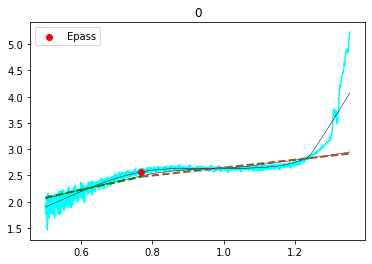

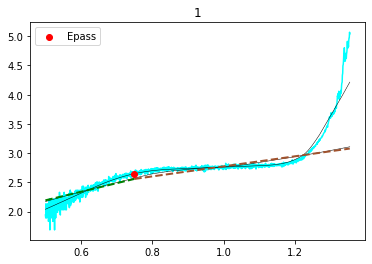

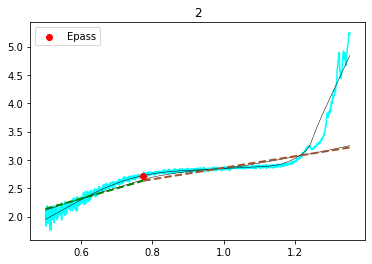

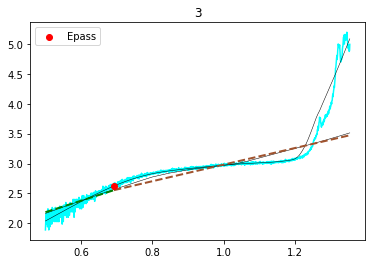

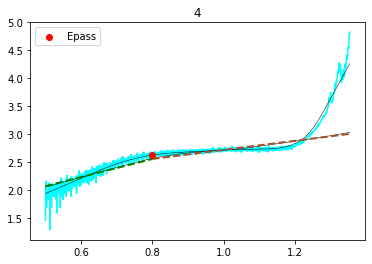

...

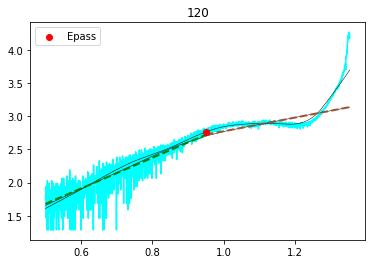

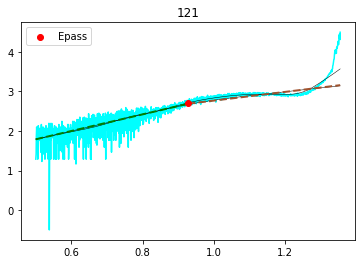

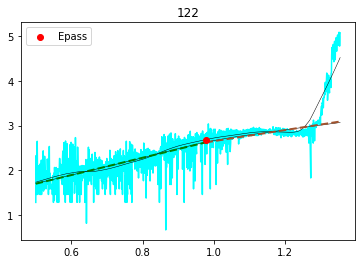

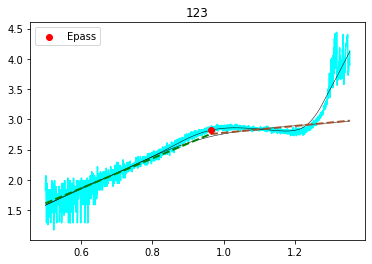

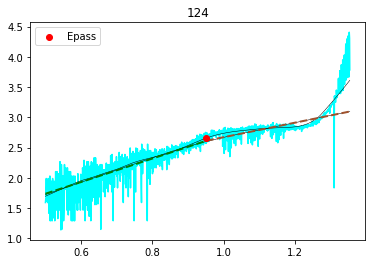

In [104]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  df_ylow_log.columns 

#collect all of the slopes and intercepts for the two parts
Epass_E, Epass_j = [],[]

#initialise the two models for part 1 and part 2
model1 = LinearRegression()
model2 = LinearRegression()

for (index, column) in enumerate(column_names):
    fig, ax = plt.subplots()
    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)

    ax.set_title(column)
    
    # Initialize the r2 values
    r2_final1, r2_final2 = 0, 0
        
    if column in class4 and column not in class3: # leave class3 (early passivity) to the end
        
        limits_max= range(limits_max_lower_i,limits_max_upper_i+1,1) # row indexes
        df_limits_max=df_ylow_log.iloc[limits_max,:]
        E_limits_max=E.iloc[limits_max]
    
        maxval=argrelmax(df_limits_max[column].values,order=2)
        
        ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
        ax.scatter(E_limits_max.iloc[maxval[0][-1]], df_limits_max[column].iloc[maxval[0][-1]],marker='x',s=200, c='g',linewidths=2,zorder=3,label="Epass")    
        ax.legend()
            
        Epass_E.append(E_limits_max.iloc[maxval[0][-1]]) 
        Epass_j.append(df_limits_max[column].iloc[maxval[0][-1]])
        
    elif column not in no_passive_class+class1+class4+class3: # class1+no_passive_class --> no Epass
        
        ax.plot(E , df_ylow_log[column], color = "black",linewidth=0.5,zorder=2) # ylow

        if column not in class5:
        
            limits_pass = range(interval_lower_ipass,interval_upper_ipass+1,1)
        
        else: #column in class5:
            
            limits_pass = range(interval_lower_ipass2,interval_upper_ipass2+1,1)

        for limit in limits_pass:

             #split the data into the first part and second part
            dfE_1 =  E.iloc[:limit+1]
            dfE_2 =  E.iloc[limit:] 
            dfj_1 =  df_ylow07_log.iloc[:limit+1] # ylow07
            dfj_2 =  df_ylow07_log.iloc[limit:] # ylow07
            X1,X2 = dfE_1.values.reshape(-1, 1),dfE_2.values.reshape(-1, 1)
            y1,y2 = dfj_1[column].values.reshape(-1, 1),dfj_2[column].values.reshape(-1, 1)

            # Fit models
            regr1, regr2 = model1.fit(X1, y1), model2.fit(X2, y2)
    
            # Evaluate models
            r2_score1, r2_score2 = r2_score(y1, regr1.predict(X1)), r2_score(y2, regr2.predict(X2))

            # Store best models
            if r2_score1 > r2_final1:
                r2_final1, regr_final1 = r2_score1, regr1
            if r2_score2 > r2_final2:
                r2_final2, regr_final2 = r2_score2, regr2

        # Determine intersection
        a1, a2 = regr_final1.coef_[0], regr_final2.coef_[0]
        b1, b2 = regr_final1.intercept_, regr_final2.intercept_

        x_intersect = np.around((b1-b2)/(a2-a1),3)
        E_tempo=E.round(3)
        try:
            xi=E_tempo[E_tempo<=x_intersect.item()].index[-1]
        except:
            xi=E_tempo[E_tempo>=x_intersect.item()].index[0]

        try:
            # plot the best-fit lines up to the intersection
            x1_reg,x2_reg  = E.iloc[:xi+1],E.iloc[xi:]
            y1_reg,y2_reg  = x1_reg * a1 + b1,x2_reg * a2 + b2    
   
            ax.plot(E , df_ylow07_log[column], color = "black",linewidth=0.5,zorder=2) # ylow07
            ax.plot(x1_reg, y1_reg, linewidth = 2, color = 'green', linestyle = 'dashed')
            ax.plot(x2_reg, y2_reg, linewidth = 2, color = 'sienna', linestyle = 'dashed')

            ax.scatter(E.iloc[xi],df_ylow_log[column].iloc[xi],color="red",zorder=3,label="Epass") #ylow instead of ylow07                  
            ax.legend()
            
            Epass_E.append(E.iloc[xi])
            Epass_j.append(df_ylow_log[column].iloc[xi]) # ylow
        except:
            print(column)
    
    elif column in class3: # Epass: the first (E,j) pair of the dataset - ylow
        Epass_E.append(E.iloc[0])
        Epass_j.append(df_ylow_log[column].iloc[0])
        ax.plot(E , df_ylow_log[column], color = "black",linewidth=0.5,zorder=2) # ylow
        ax.scatter(E.iloc[0],df_ylow_log[column].iloc[0],color="orange",zorder=3,label="Epass") #ylow instead of ylow07                  
        ax.legend()
            
    else:
        Epass_E.append(np.nan) #class1+no_passive_class --> np.nan
        Epass_j.append(np.nan)

In [114]:
# unsatisfactory Epass estimates from the LR-based algorithm --> ML test set
# list of maps (data samples) with unsatisfactory estimates 
maps_test_list_pass=[3,5,12,20,25,27,28,31,32,34,35,36,37,43,44,46,74,105,113]

# Machine Learning

### data pre-processing

To focus specifically on the relevant regions of the PP curves that encompass the passivity descriptors, the log(j) Vs E (smoothed) curves were partitioned through a data slicing procedure. The sliced curves presented 700 data points (0.539 V in potential range), sufficiently capturing the regions related to Epass with high security margins. 

In [108]:
E_sliced_pass=E.iloc[100:800]
j_sliced_pass=df_log.iloc[100:800,:]
j_sliced_smooth_pass=df_ylow_log.iloc[100:800,:]

### plotting the raw, smoothed and sliced log(j) Vs E curves

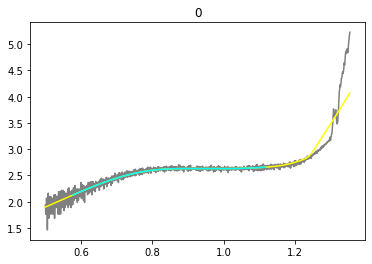

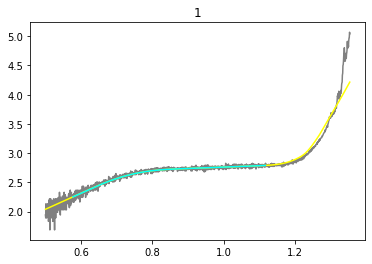

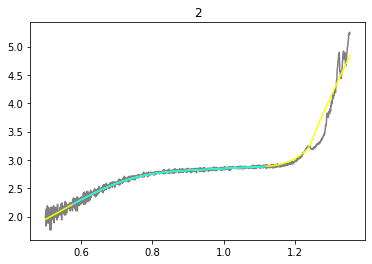

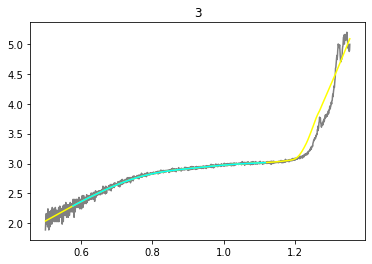

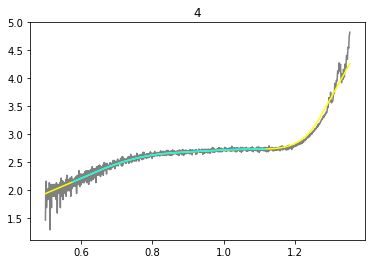

...

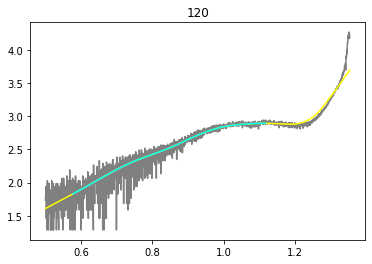

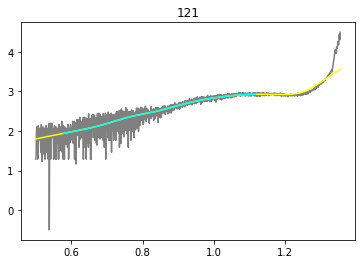

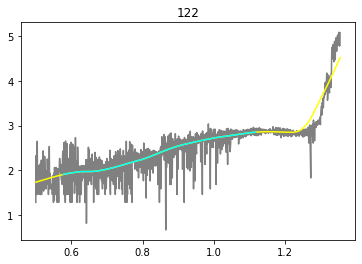

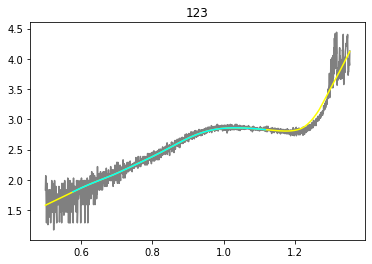

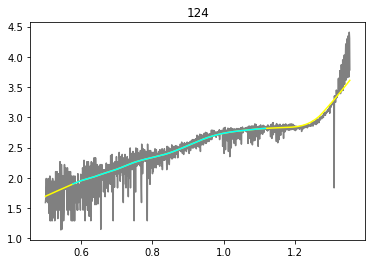

In [109]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

column_names =  j_sliced_pass.columns 

for index, column in enumerate(column_names):
    if column not in class1+no_passive_class+class3:
        fig, ax = plt.subplots() 
    
        ax.plot(E , df_log[column], color = "grey",zorder=1)
        ax.plot(E , df_ylow_log[column], color = "yellow",zorder=2)
        ax.plot(E_sliced_pass , j_sliced_smooth_pass[column], color = "cyan",zorder=3)
        ax.set_title(column)

### feature engineering 

In [111]:
# defining the log(j) values from the sliced curves as data features (columns of the df)
j_transp_pass=j_sliced_smooth_pass.T
j_transp_pass.index.name="Maps"

# drop no_passive_class from features df
j_transp_pass = j_transp_pass.drop(class1+no_passive_class+class3, axis=0) 
j_transp_pass

,100,101,102,103,104,105,106,107,108,109,...,790,791,792,793,794,795,796,797,798,799
Maps,,,,,,,,,,,,,,,,,,,,,
0,2.129423,2.131242,2.133973,2.135794,2.138529,2.141266,2.143091,2.145831,2.147658,2.150399,...,2.654422,2.654837,2.655116,2.655537,2.655821,2.656250,2.656538,2.656975,2.657269,2.657714
1,2.251507,2.253181,2.255691,2.257363,2.259872,2.262379,2.264051,2.266558,2.268229,2.270737,...,2.786558,2.786847,2.787043,2.787342,2.787545,2.787853,2.788062,2.788381,2.788597,2.788926
2,2.220302,2.222420,2.225595,2.227712,2.230886,2.234060,2.236175,2.239347,2.241461,2.244631,...,2.882858,2.883207,2.883442,2.883800,2.884041,2.884408,2.884656,2.885033,2.885287,2.885675
3,2.292043,2.294033,2.297018,2.299007,2.301990,2.304972,2.306958,2.309937,2.311921,2.314895,...,3.013251,3.013533,3.013723,3.014010,3.014203,3.014496,3.014693,3.014993,3.015195,3.015501
4,2.150414,2.152103,2.154636,2.156324,2.158858,2.161392,2.163081,2.165615,2.167304,2.169838,...,2.735301,2.735425,2.735510,2.735641,2.735732,2.735872,2.735969,2.736118,2.736221,2.736380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,1.830698,1.832460,1.835104,1.836868,1.839516,1.842165,1.843931,1.846581,1.848347,1.850994,...,2.893017,2.893038,2.893049,2.893061,2.893066,2.893068,2.893066,2.893058,2.893050,2.893034
121,1.936763,1.937856,1.939498,1.940593,1.942239,1.943886,1.944986,1.946636,1.947736,1.949385,...,2.923798,2.923977,2.924091,2.924254,2.924357,2.924505,2.924598,2.924730,2.924813,2.924929
122,1.910499,1.911659,1.913399,1.914559,1.916301,1.918047,1.919213,1.920970,1.922147,1.923925,...,2.848100,2.848832,2.849310,2.850012,2.850470,2.851142,2.851579,2.852221,2.852638,2.853249


#### data targeting and data splitting

In [116]:
# defining and selecting the data target (Epit (V))
labels_pass = pd.DataFrame({"Epass_E":Epass_E})
labels_pass.index.name="Maps"
labels_pass = labels_pass.drop(class1+no_passive_class+class3, axis=0)  # drop no_passive_class from target df

# splitting the data into training and test sets
test_labels_pass=labels_pass.loc[maps_test_list_pass] # test set = unsatisfactory Epit estimates 
j_test_pass=j_transp_pass.loc[maps_test_list_pass]
j_train_pass=j_transp_pass.drop(maps_test_list_pass, axis=0)
train_labels_pass=labels_pass.drop(maps_test_list_pass, axis=0)
train_labels_pass

,Epass_E
Maps,
0,0.769066
1,0.749840
2,0.775475
4,0.799890
6,0.822474
...,...
120,0.951262
121,0.927152
122,0.976592


#### Data Scaling

Given that machine learning algorithms can be sensitive to feature magnitude, we standardize our features to have zero mean and unit variance. This is done using the `StandardScaler()` from `scikit-learn`.

In [117]:
scale_pipe = Pipeline([
    ('scaler', StandardScaler())   
])

j_transp_scaled_pass = scale_pipe.fit_transform(j_transp_pass)  

j_transp_scaled_pass = pd.DataFrame(j_transp_scaled_pass)
j_transp_scaled_pass.index=j_transp_pass.index # getting correct maps (pd.DataFrame reset index)
j_transp_scaled_pass.index.name="Maps"

# splitting the scaled data into training and test sets
j_train_scaled_pass = j_transp_scaled_pass.drop(maps_test_list_pass, axis=0) 
j_test_scaled_pass = j_transp_scaled_pass.loc[maps_test_list_pass,:] # better to use .loc
j_test_scaled_pass
# PS: note that target variables (`labels`) are not scaled since they represent actual output values we aim to predict

,0,1,2,3,4,5,6,7,8,9,...,690,691,692,693,694,695,696,697,698,699
Maps,,,,,,,,,,,,,,,,,,,,,
3,1.317102,1.318378,1.320283,1.321548,1.323434,1.325307,1.326548,1.328396,1.329618,1.331436,...,0.404368,0.403744,0.403325,0.402694,0.402271,0.401632,0.401204,0.400559,0.400127,0.399474
5,0.930246,0.930443,0.930736,0.930928,0.931211,0.931484,0.931659,0.931908,0.932061,0.932269,...,-0.022192,-0.019599,-0.017844,-0.015174,-0.013370,-0.010631,-0.008785,-0.005986,-0.004103,-0.001253
12,2.090222,2.088930,2.086991,2.085699,2.083761,2.081827,2.080541,2.078615,2.077335,2.075420,...,0.799987,0.806552,0.810988,0.817732,0.822289,0.829222,0.833908,0.841039,0.845860,0.853197
20,-1.879908,-1.881109,-1.882869,-1.884012,-1.885673,-1.887262,-1.888275,-1.889715,-1.890615,-1.891866,...,-1.794842,-1.795191,-1.795267,-1.795155,-1.794934,-1.794386,-1.793879,-1.792906,-1.792119,-1.790730
25,1.441349,1.440585,1.439432,1.438658,1.437490,1.436314,1.435525,1.434335,1.433538,1.432336,...,-0.333673,-0.330969,-0.329111,-0.326238,-0.324262,-0.321200,-0.319093,-0.315824,-0.313572,-0.310079
27,-0.160274,-0.160026,-0.159681,-0.159471,-0.159192,-0.158958,-0.158829,-0.158681,-0.158613,-0.158560,...,-0.491824,-0.490591,-0.489760,-0.488503,-0.487657,-0.486375,-0.485514,-0.484209,-0.483333,-0.482009
28,1.639832,1.638711,1.637022,1.635892,1.634188,1.632475,1.631328,1.629597,1.628436,1.626683,...,-0.432227,-0.433641,-0.434574,-0.435958,-0.436869,-0.438221,-0.439110,-0.440427,-0.441292,-0.442572
31,1.340167,1.341086,1.342463,1.343382,1.344761,1.346144,1.347069,1.348462,1.349395,1.350800,...,-0.050194,-0.053233,-0.055262,-0.058311,-0.060348,-0.063410,-0.065455,-0.068531,-0.070587,-0.073678
32,0.501305,0.501063,0.500699,0.500456,0.500092,0.499733,0.499497,0.499150,0.498925,0.498600,...,-0.357145,-0.354066,-0.351968,-0.348755,-0.346570,-0.343225,-0.340953,-0.337480,-0.335124,-0.331528


## ANN

### Epass model

In [118]:
# reducing the complexity of the log(j) data by diminishing its dimensionality: selecting every 60th feature from the "j_transp_scaled_pass" df
j_transp_scaled_pass_red=j_transp_scaled_pass.copy()
j_transp_scaled_pass_red=j_transp_scaled_pass_red[np.arange(0,j_transp_scaled_pass.shape[1],60)]

j_train_scaled_pass_red=j_train_scaled_pass.copy()
j_train_scaled_pass_red=j_train_scaled_pass_red[np.arange(0,j_train_scaled_pass.shape[1],60)]

j_test_scaled_pass_red=j_test_scaled_pass.copy()
j_test_scaled_pass_red=j_test_scaled_pass_red[np.arange(0,j_test_scaled_pass.shape[1],60)]
j_test_scaled_pass_red

,0,60,120,180,240,300,360,420,480,540,600,660
Maps,,,,,,,,,,,,
3,1.317102,1.367639,1.365120,1.340689,1.271897,1.112602,0.900194,0.706038,0.570565,0.498591,0.447712,0.420602
5,0.930246,0.911937,0.862285,0.778811,0.662274,0.516112,0.351212,0.201646,0.086157,-0.001391,-0.063218,-0.066760
12,2.090222,1.988472,1.873248,1.758507,1.620706,1.400621,1.142006,0.917053,0.765650,0.686619,0.606578,0.664499
20,-1.879908,-1.889415,-1.598414,-0.931463,-0.322575,-0.124201,-0.047139,-0.116443,-0.293120,-0.505640,-0.885774,-1.634712
25,1.441349,1.356513,1.220690,1.056670,0.851713,0.597849,0.335815,0.098302,-0.105152,-0.275638,-0.373844,-0.379187
27,-0.160274,-0.141564,-0.046411,0.130987,0.289157,0.340975,0.244315,0.057176,-0.151754,-0.362747,-0.513506,-0.519465
28,1.639832,1.532372,1.389586,1.236474,1.059849,0.816650,0.535639,0.263912,0.030310,-0.164310,-0.306564,-0.394813
31,1.340167,1.392053,1.395258,1.362695,1.278573,1.099174,0.875580,0.672740,0.503559,0.353594,0.185779,0.026639
32,0.501305,0.499200,0.490558,0.436911,0.327366,0.166474,-0.015733,-0.171993,-0.282604,-0.367939,-0.414171,-0.409817


#### visualising the non-scaled / scaled features (sliced log(j)) and the 13 selected input features

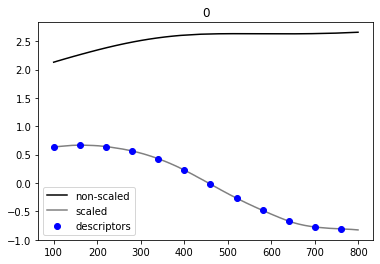

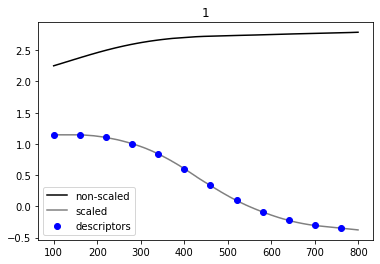

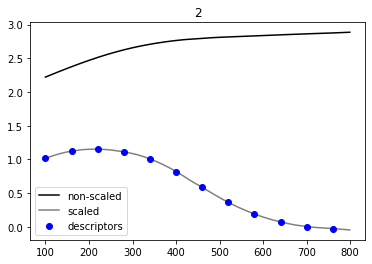

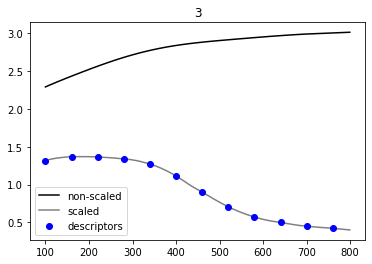

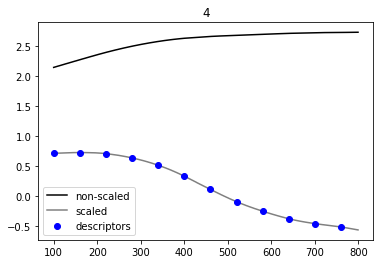

...

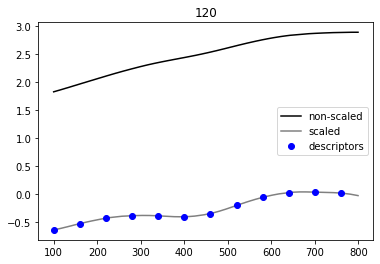

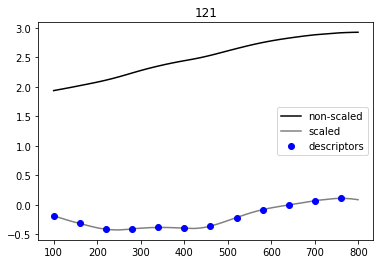

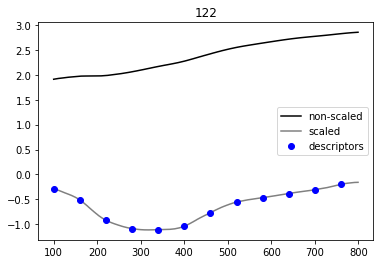

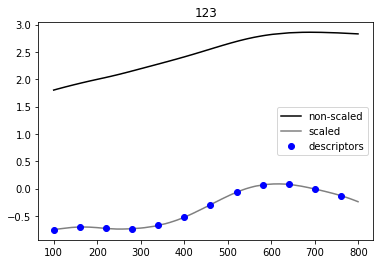

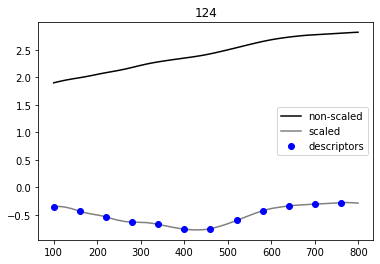

In [120]:
# for avoiding Warnings
plt.rcParams.update({'figure.max_open_warning': 0})

index_names =  j_transp_scaled_pass_red.index 

for index in index_names:
    fig, ax = plt.subplots() 
    
    ax.plot(j_transp_pass.loc[index,:], color = "k",zorder=1,label="non-scaled")
    ax.plot(j_transp_scaled_pass.columns+j_transp_pass.columns[0],j_transp_scaled_pass.loc[index,:], color = "grey",zorder=1,label="scaled")
    ax.scatter(j_transp_scaled_pass_red.loc[index,:].index+j_transp_pass.columns[0],j_transp_scaled_pass_red.loc[index,:],c="b",zorder=2,label="descriptors")
    ax.set_title(index)
    ax.legend()

#### Setting Up Neural Network Parameters

In [ ]:
input_shape_pass = j_transp_scaled_pass_red.shape[1] 
input_shape_pass=(input_shape_pass,)
input_shape_pass 

epochs=200

batches_pass=int(j_train_scaled_pass_red.shape[0])
batches_pass

#### Cross-validation for Neural Network Training

In [ ]:
#### Neural Network Training with Cross-validation:

def cross_validate(X, y, K = 10, **kwargs):
    scores = []
    histories = []
    for train, test in KFold(n_splits=K, shuffle=True).split(X,y): 
        # compiling the model        
        model_pass.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination]) 
        histories.append(model_pass.fit(X.iloc[train], y.iloc[train],validation_data=(X.iloc[test],y.iloc[test]),batch_size=batches_pass,epochs=epochs)) 
        # using "model.fit" in the same code block (for restarting from the initial epoch each time)        
        scores.append(model_pass.evaluate(X.iloc[test], y.iloc[test], verbose = 0)) 
        
        print("\nval_loss:", round(np.asarray(scores)[-1,0], 4))
        print("val_R2:", round(np.asarray(scores)[-1,1], 4), "\n")
        
    print(scores)
    print("\nmean R2:", round(np.asarray(scores)[:,1].mean(), 4))
    
    return scores, histories

# Model Definition
model_pass = keras.models.Sequential([                 
    keras.layers.Dense(input_shape_pass[0], activation='relu',input_shape=input_shape_pass), 
    keras.layers.Dense(12, activation='relu'),  
    keras.layers.Dense(11, activation='relu'), 
    keras.layers.Dense(1)         
])

scores, histories=cross_validate(j_train_scaled_pass_red, train_labels_pass, K = 20)

#### Model Training Histories

- **Loss:**

In [ ]:
fig, ax = plt.subplots(figsize=(12,8)) 
for h in histories:
    ax.plot(h.history["loss"],c="b")
    ax.plot(h.history["val_loss"],c="orange")

ax.plot(0,0,c="orange",label="val loss") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train loss") # plot for the sake of the legend label
ax.set_ylim(0,0.2)
ax.legend()

- **R-squared:**

In [ ]:
fig, ax = plt.subplots(figsize=(14,8)) 
for h in histories:
    ax.plot(h.history["coeff_determination"],c="b")
    ax.plot(h.history["val_coeff_determination"],c="orange")

ax.plot(0,0,c="orange",label="val R2") # plot for the sake of the legend label
ax.plot(0,0,c="b",label="train R2") # plot for the sake of the legend label
ax.set_ylim(0.5,1)
ax.legend()

In [ ]:
# Model Architecture
model_pass.summary()

#### Re-Training with Model Pruning

In [ ]:
n=40 # epochs multiplier

In [ ]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled_pass.shape[0] /batches_pass).astype(np.int32) * epochs*n
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model_pass, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [ ]:
model = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape_pass[0], activation='relu',input_shape=input_shape_pass), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'), 
            keras.layers.Dense(1)    
])

keras.optimizers.Adam(learning_rate=0.001) # default learning rate

model_pass.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model_pass.fit(j_train_scaled_pass_red, train_labels_pass,batch_size=batches_pass,epochs=epochs*n,validation_split=0.1,callbacks=pruning_callback)

In [ ]:
fig, ax = plt.subplots() 
ax.plot(history.history["loss"])
ax.plot(history.history["val_loss"],c="orange")

In [ ]:
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"])
ax.plot(history.history["val_coeff_determination"],c="orange")
ax.set_ylim(0.9,1.01)
ax.set_xlim(0,epochs*n)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

In [ ]:
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["val_coeff_determination"],c="orange")
ax.set_ylim(-10,1)
ax.set_xlim(0,epochs*n)

#### Full Dataset Training with Model Pruning

In [ ]:
epochs_pruned=6000 # decreasing the number of epochs

In [ ]:
initial_sparsity = 0.0
final_sparsity = 0.9
begin_step = 0
end_step = np.ceil(j_transp_scaled_pass.shape[0] /batches_pass).astype(np.int32) * epochs_pruned
pruning_params = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(
            initial_sparsity=initial_sparsity,
            final_sparsity=final_sparsity,
            begin_step=begin_step,
            end_step=end_step)
    }
model = tfmot.sparsity.keras.prune_low_magnitude(model_pass, **pruning_params)
pruning_callback = tfmot.sparsity.keras.UpdatePruningStep()

In [ ]:
model_pass = keras.models.Sequential([
                                 
            keras.layers.Dense(input_shape_pass[0], activation='relu',input_shape=input_shape_pass), 
            keras.layers.Dense(12, activation='relu'),  
            keras.layers.Dense(11, activation='relu'),
            keras.layers.Dense(1)                    
])

model_pass.compile(loss='mean_squared_error', optimizer='adam', metrics=[coeff_determination])

history=model_pass.fit(j_train_scaled_pass_red, train_labels_pass,batch_size=batches_pass,epochs=epochs_pruned,callbacks=pruning_callback)

(-1e-05, 0.001)

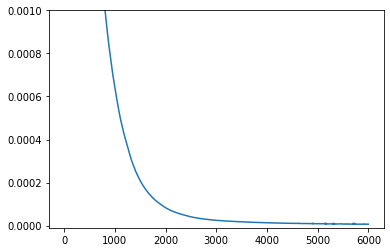

In [215]:
# loss
fig, ax = plt.subplots() 
ax.plot(history.history["loss"])
ax.set_ylim(-0.00001,0.001)

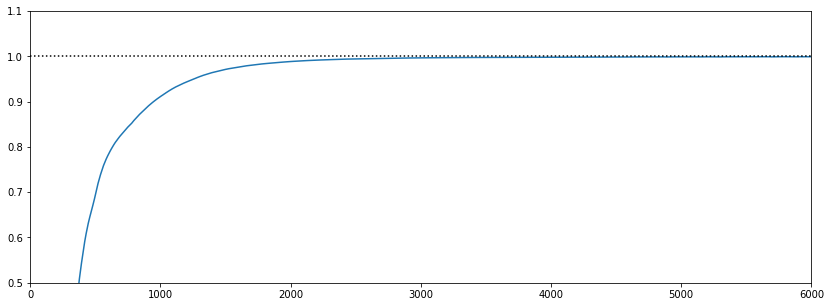

In [216]:
# R²
fig, ax = plt.subplots(figsize=(14,5)) 
ax.plot(history.history["coeff_determination"])
ax.set_ylim(0.5,1.1)
ax.set_xlim(0,epochs_pruned)
plt.axhline(y = 1, color = 'k', linestyle = 'dotted')

In [217]:
predict_test_pass=model_pass.predict(j_test_scaled_pass_red) 
predict_test_pass

1/1 [==============================] - 0s 19ms/step


array([[0.80538803],
       [0.76085037],
       [0.74587905],
       [0.81587005],
       [0.7733712 ],
       [0.8877723 ],
       [0.8395307 ],
       [0.79644084],
       [0.78522533],
       [0.76388204],
       [0.8170963 ],
       [0.7811287 ],
       [0.78018945],
       [0.7984492 ],
       [0.7870302 ],
       [0.8716114 ],
       [0.9429954 ],
       [0.9275087 ],
       [0.90129846]], dtype=float32)

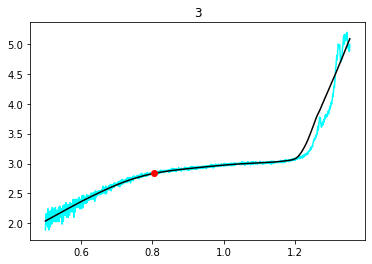

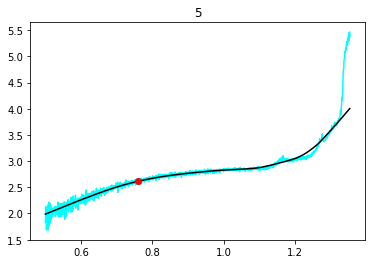

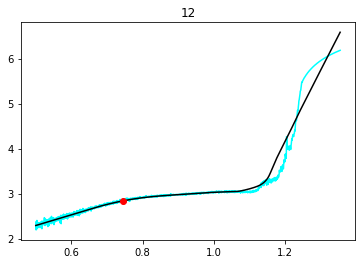

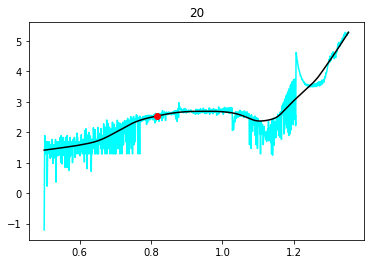

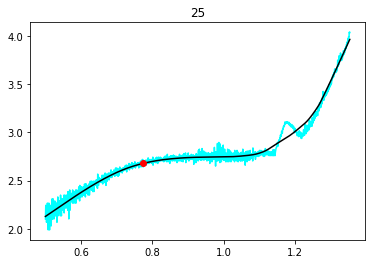

...

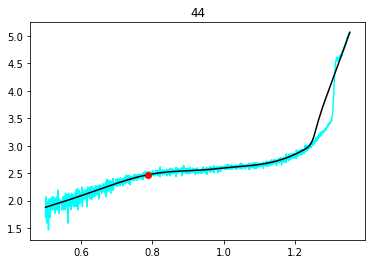

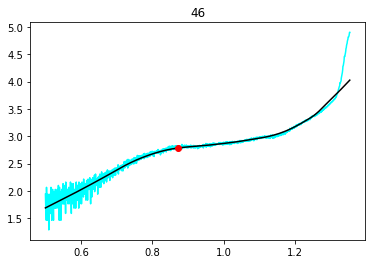

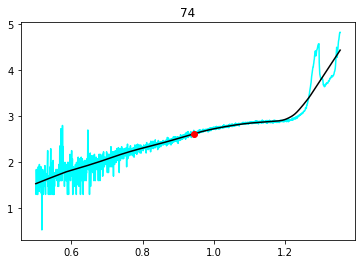

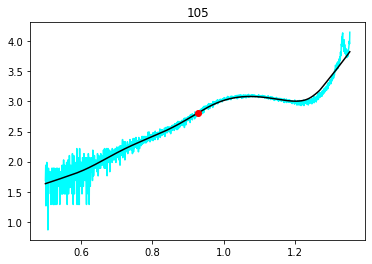

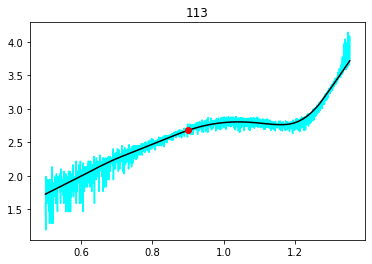

In [218]:
# testing set
index_names =  j_test_scaled_pass_red.index 

for index, column in enumerate(index_names):
    fig, ax = plt.subplots() 
    ax.set_title(column)    
    ax.plot(E , df_log[column], color = "cyan",zorder=1)
    ax.plot(E , df_ylow_log[column], color = "black",zorder=2)
    ax.scatter(predict_test_pass[index][0], df_ylow_log[column][E>=predict_test_pass[index][0]].iloc[0], color = "red",zorder=3)
# log(jpass) was calculated from the output Epass (log(j) is a function of E)

#### performance evaluation on training set

3/3 [==============================] - 0s 0s/step


Text(0.5, 1.0, 'Epass')

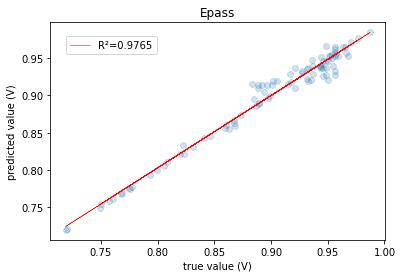

In [255]:
predict_train_pass=model_pass.predict(j_train_scaled_pass_red)
R2=round(r2_score(train_labels_pass, predict_train_pass),4)

fig, ax = plt.subplots()

ax.scatter(train_labels_pass,predict_train_pass,alpha=0.2)
ax.set_ylabel("predicted value (V)")
ax.set_xlabel("true value (V)")

#obtain m (slope) and b(intercept) of linear regression line
x=train_labels_pass["Epass_E"]
model_lin = np.polyfit(x,predict_train_pass.flatten(),1)
ax.plot(x, model_lin[0]*x+model_lin[1],c="r",linewidth=0.5,label="R²="+str(R2))

fig.legend(loc="upper left", bbox_to_anchor=(0.15, 0.85))
ax.set_title('Epass')

### storing the Epass (x,y) values in a df

In [285]:
index_names =  j_transp_scaled_pass.index 

predict_entire_pass=model_pass.predict(j_transp_scaled_pass_red) # deploying the trained model on the entire (training + test) set

Epass_x, Epass_y = [],[]
for e,(index,column) in zip(predict_entire_pass,enumerate(index_names)):
    Epass_x.append(e[0])
    Epass_y.append(df_ylow_log[column][E>=predict_entire_pass[index][0]].iloc[0])
    
pass_log = pd.DataFrame({"Epass_x":Epass_x,"Epass_y":Epass_y})
pass_log.index=j_transp_scaled_pass.index
pass_log.index.name="Maps"
pass_log

4/4 [==============================] - 0s 0s/step


,Epass_x,Epass_y
Maps,,
0,0.768610,2.566858
1,0.754301,2.653883
2,0.773990,2.723519
3,0.805388,2.836968
4,0.799734,2.627179
...,...,...
120,0.952490,2.768596
121,0.932472,2.719641
122,0.976918,2.687738


In [288]:
# inserting data samples from no_passive_class (Epass = NaA by default)
Epass_x_no_pass, Epass_y_no_pass = [],[]
for i in class1+no_passive_class+class3:
    Epass_x_no_pass.append(Epass_E[i])
    Epass_y_no_pass.append(Epass_j[i])
    
pass_log_no_pass = pd.DataFrame({"Epass_x":Epass_x_no_pass,"Epass_y":Epass_y_no_pass})
pass_log_no_pass.index=class1+no_passive_class+class3
pass_log_no_pass.index.name="Maps"

pass_log_no_pass.sort_index(ascending=True,inplace=True)
pass_log=pass_log.append(pass_log_no_pass) # run this only once
pass_log.sort_index(ascending=True,inplace=True)
pass_log

,Epass_x,Epass_y
Maps,,
0,0.768610,2.566858
1,0.754301,2.653883
2,0.773990,2.723519
3,0.805388,2.836968
4,0.799734,2.627179
...,...,...
120,0.952490,2.768596
121,0.932472,2.719641
122,0.976918,2.687738


### storing the Epit (x,y) and Epass (x,y) values in a df (and exporting it as a CSV file)

In [289]:
# choosing the directory 
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_log=pd.concat([pit_log,pass_log],axis=1)
pit_pass_log.to_csv('Epit_Epass_005_100.csv', index=True)
pit_pass_log

,Epit_x,Epit_y,Epass_x,Epass_y
Maps,,,,
0,1.216614,2.788656,0.768610,2.566858
1,1.215703,2.942106,0.754301,2.653883
2,1.207353,3.055912,0.773990,2.723519
3,1.210903,3.133338,0.805388,2.836968
4,1.214762,2.885653,0.799734,2.627179
...,...,...,...,...
120,1.272058,3.104715,0.952490,2.768596
121,1.290122,3.177879,0.932472,2.719641
122,1.248610,2.938377,0.976918,2.687738


###  uploading the Epit (x,y) and Epass (x,y) values as originally produced 
#### reproduced in "Estimating pitting descriptors of 316L stainless steel by machine learning and statistical analysis"

In [290]:
# choosing the directory for uploading the dataset originally produced (to account for the stochastic nature of ANN outputs)
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_log=pd.read_csv('Epit_Epass_005_100.csv',index_col=0) # to account for the stochastic nature of ANN
pit_pass_log

,Epit_x,Epit_y,Epass_x,Epass_y
Maps,,,,
0,1.218677,2.794826,0.767263,2.564919
1,1.212022,2.928202,0.749364,2.647921
2,1.205838,3.050136,0.775121,2.724745
3,1.209065,3.123336,0.796761,2.825359
4,1.217226,2.898542,0.797337,2.625062
...,...,...,...,...
120,1.273632,3.115136,0.949848,2.763749
121,1.291927,3.191764,0.926661,2.707620
122,1.244587,2.912660,0.974427,2.683621


#### dataset uploaded above is permanently stored at: https://data.mendeley.com/datasets/5x4dmc38bg/1
Bertolucci Coelho, Leonardo; Ustarroz, Jon (2023), “Epit and Epass descriptors of 316L stainless steel estimated by Machine Learning”, Mendeley Data, V1, doi: 10.17632/5x4dmc38bg.1

# Statistical analysis

#### importing theoretical fitting distributions

In [291]:
!pip install distfit


[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [292]:
from distfit import distfit
from scipy.stats import norm

#### computing the mean and median values of the Epit_y and Epass_y (log(j)) distributions for plotting histograms

In [294]:
Epit_y_mean05=np.mean(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5])
Epit_y_median05=np.nanpercentile(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5],50)

Epass_y_mean05=np.mean(pit_pass_log['Epass_y'][round(pit_pass_log['Epass_x'],2)!=0.5])
Epass_y_median05=np.nanpercentile(pit_pass_log['Epass_y'][round(pit_pass_log['Epass_x'],2)!=0.5],50)

#### Kernel Density Estimation (KDE) of the bivariate distributions of Epit/log(jpit) and  Epass/log(jpass)

https://stackoverflow.com/questions/31198020/how-to-find-local-maxima-in-kernel-density-estimation

In [295]:
def estimate_maxima(data):
    data.dropna(inplace=True)
    k = kde.gaussian_kde(data)
    no_samples = len(data)
    samples = np.linspace(data.min(), data.max(), no_samples)
    probs = k.evaluate(samples)
    maxima_index = probs.argmax()
    maxima = samples[maxima_index]
    return maxima

In [296]:
Epit_x_kde,Epit_y_kde=estimate_maxima(pit_pass_log["Epit_x"]),estimate_maxima(pit_pass_log["Epit_y"])
Epass_x_kde,Epass_y_kde=estimate_maxima(pit_pass_log["Epass_x"]),estimate_maxima(pit_pass_log["Epass_y"])

### plotting histograms of Epit_x and Epass_x (Epit and Epass (V))

In [298]:
# excluding outliers for curve fitting purpose: combining IQR-based and Z-score-based methods
Epit=pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5]
Epass=pit_pass_log['Epass_x'][round(pit_pass_log['Epass_x'],2)!=0.5]

# outliers removal for Epass based on IQR
Q1pass,Q3pass=np.percentile(Epass.dropna(),[25,75])
IQRpass=Q3pass-Q1pass
lower_bondpass=Q1pass 
IQR_outlierspass=Epass[(Epass< lower_bondpass)] 

maskpass = Epass.isin(IQR_outlierspass)

not_in_list_maskpass = ~maskpass
df_not_in_listpassIQR = Epass.loc[not_in_list_maskpass] 


Epit_sort=np.sort(Epit)
Epass_sort=np.sort(df_not_in_listpassIQR.dropna()) # ****

def Zscore_outliers(data):
    outliers =[]
    threshold=3 #3  x std 
    mean=np.mean(data)
    std=np.std(data)
    for i in data:
        z_score=(i-mean)/std
        if np.abs(z_score) > threshold:
            outliers.append(i)
    return outliers

Zscore_outliers_list_Epit=Zscore_outliers(Epit_sort)
Zscore_outliers_list_Epass=Zscore_outliers(Epass_sort)

maskpit = Epit.isin(Zscore_outliers_list_Epit)
maskpass = Epass.isin(Zscore_outliers_list_Epass)

not_in_list_maskpit = ~maskpit
not_in_list_maskpass = ~maskpass
df_not_in_listpit = Epit.loc[not_in_list_maskpit]
df_not_in_listpass = df_not_in_listpassIQR.loc[not_in_list_maskpass] # ****

norm RSS: 199.39483250741
norm RSS: 115.36468428483113


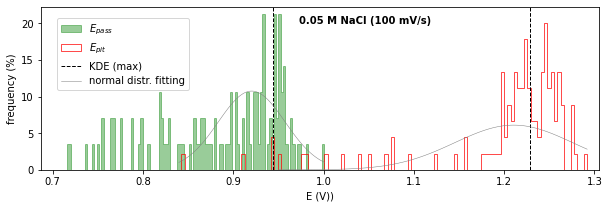

In [299]:
unique_pass=np.unique(pit_pass_log['Epass_x'][round(pit_pass_log['Epass_x'],2)!=0.5])
unique_pit=np.unique(pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5])
bins_pass=len(unique_pass)
bins_pit=len(unique_pit)

fig, ax = plt.subplots(figsize=(10,3))

ax.hist(pit_pass_log['Epass_x'][round(pit_pass_log['Epass_x'],2)!=0.5],density=True,bins=bins_pass,color="green",fill=True,histtype='step',alpha=0.4,label="$E_{pass}$")

ax.hist(pit_pass_log['Epit_x'][round(pit_pass_log['Epit_x'],2)!=0.5], density=True,bins=bins_pit,color="red",fill=False,histtype='step',linewidth=0.7,label="$E_{pit}$")

ax.axvline(x=estimate_maxima(df_not_in_listpassIQR),color = 'k',linestyle = 'dashed',linewidth = 1,zorder=2,label="KDE (max)")
ax.axvline(x=Epit_x_kde,color = 'k',linestyle = 'dashed',linewidth = 1,zorder=2)

ax.set_xlabel("E (V))")
ax.set_ylabel("frequency (%)")
ax.set_xlim(0.687,1.305)
ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 10, y=0.86,x=0.58,weight='bold') 

#without outliers
Epass_sortwo=np.sort(df_not_in_listpass.dropna())
xpass=np.linspace(Epass_sortwo[0],Epass_sortwo[-1],len(unique_pass)) 
dist = distfit(distr="norm",smooth=20,bins=round(len(unique_pass)/2)) 
dist.fit_transform(Epass_sortwo, verbose=1)  
print(dist.model['name']+" RSS: "+str(dist.model['score'])) 
model=norm.pdf(xpass, dist.model['params'][0],dist.model['params'][1])
ax.plot(xpass,model,"grey",linewidth=0.5,label="normal distr. fitting")

Epit_sortwo=np.sort(df_not_in_listpit.dropna())
xpit=np.linspace(Epit_sortwo[0],Epit_sortwo[-1],len(unique_pit)) 
dist = distfit(distr="norm",smooth=20,bins=round(len(unique_pit)/2)) 
dist.fit_transform(Epit_sortwo, verbose=1)  
print(dist.model['name']+" RSS: "+str(dist.model['score'])) 
model=norm.pdf(xpit, dist.model['params'][0],dist.model['params'][1])
ax.plot(xpit,model,"grey",linewidth=0.5)

fig.legend(loc="upper left", bbox_to_anchor=(0.14, 0.85))

### plotting histograms of Epit_y and Epass_y (log(jpit) and log(jpass) (µA/cm²))

Text(0.55, 0.96, '0.05 M NaCl (100 mV/s)')

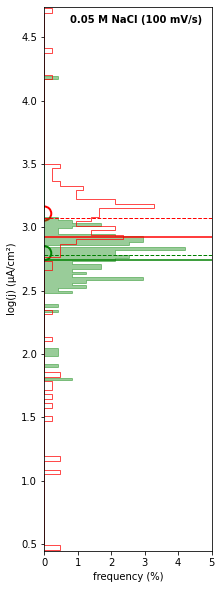

In [300]:
unique_pass=np.unique(pit_pass_log['Epass_y'][round(pit_pass_log['Epass_x'],2)!=0.5]) 
unique_pit=np.unique(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5]) 
bins_pass=len(unique_pass)
bins_pit=len(unique_pit)

fig, ax = plt.subplots(figsize=(3,10))

ax.hist(pit_pass_log['Epass_y'][round(pit_pass_log['Epass_x'],2)!=0.5],density=True,bins=bins_pass,color="green",fill=True,histtype='step',alpha=0.4,orientation="horizontal",label="$E_{pass}$")
ax.axhline(y = Epass_y_mean05, color = 'green', linewidth = 1.5,zorder=2,label="mean")
ax.axhline(y = Epass_y_median05, color = 'green',linestyle = 'dashed',linewidth = 1,zorder=2,label="median")

ax.hist(pit_pass_log['Epit_y'][round(pit_pass_log['Epit_x'],2)!=0.5], density=True,bins=bins_pit,color="red",fill=False,histtype='step',linewidth=0.7,orientation="horizontal",label="$E_{pit}$")
ax.axhline(y = Epit_y_mean05, color = 'red', linewidth = 1.5,zorder=2,label="mean")
ax.axhline(y = Epit_y_median05, color = 'red',linestyle = 'dashed',linewidth = 1,zorder=2,label="median")

ax.scatter(0,Epass_y_kde,marker="o",s=200,facecolors='none',edgecolors="g",linewidth=2)
ax.scatter(0,Epit_y_kde,marker="o",s=200,facecolors='none',edgecolors="r",linewidth=2)

ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("frequency (%)")
ax.set_ylim(min(pit_pass_log['Epit_y'])-0.01,max(pit_pass_log['Epit_y'])+0.01) 
ax.set_xlim(0,5) 
ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 10, y=0.96,x=0.55,weight='bold') 

### hypothesis testing
#### null hypothesis 1: the Epass (V) is normally distributed
#### null hypothesis 2: the Epit (V) is normally distributed

Since the p-value is less than 0.05, we reject the null hypothesis. 
We have sufficient evidence to say that the sample data does not come from a normal distribution.

Since the p-value is not less than 0.05, we fail to reject the null hypothesis. 
We do not have sufficient evidence to say that the sample data does not come from a normal distribution.

#### normality tests

In [301]:
from scipy.stats import shapiro, normaltest, anderson

def test_normality(data, hypothesis_num):
    # Shapiro-Wilk Test
    stat, p = shapiro(data)
    print(f"p={p:.3f}")
    if p < 0.05:
        print(f"The null hypothesis {hypothesis_num} can be rejected")
    else:
        print(f"The null hypothesis {hypothesis_num} cannot be rejected: normal distribution")

    # D'Agostino and Pearson's Test
    stat, p = normaltest(data)
    print(f"p={p:.3f}")
    if p < 0.05:
        print(f"The null hypothesis {hypothesis_num} can be rejected")
    else:
        print(f"The null hypothesis {hypothesis_num} cannot be rejected: normal distribution")
    
    # Anderson-Darling Test
    result = anderson(data)
    for i in range(len(result.critical_values)):
        slevel, cvalues = result.significance_level[i], result.critical_values[i]
        if result.statistic < result.critical_values[i]:
            print(f'{slevel:.3f}: {cvalues:.3f}, data looks normal (fail to reject H0)')
        else:
            print(f'{slevel:.3f}: {cvalues:.3f}, data does not look normal (reject H0)')

# Testing normality for Epass_sort and Epit_sort
print("Epass")
test_normality(Epass_sort, 1)
print("\nEpit")
test_normality(Epit_sort, 2)

# Testing normality for Epass_sortwo and Epit_sortwo (without outliers)
print("\nEpass w/o outliers")
test_normality(Epass_sortwo, 1)
print("\nEpit w/o outliers")
test_normality(Epit_sortwo, 2)

Epass
p=0.003
The null hypothesis 1 can be rejected
p=0.056
The null hypothesis 1 cannot be rejected: normal distribution
15.000: 0.551, data does not look normal (reject H0)
10.000: 0.628, data does not look normal (reject H0)
5.000: 0.753, data does not look normal (reject H0)
2.500: 0.879, data does not look normal (reject H0)
1.000: 1.045, data does not look normal (reject H0)

Epit
p=0.000
The null hypothesis 2 can be rejected
p=0.000
The null hypothesis 2 can be rejected
15.000: 0.559, data does not look normal (reject H0)
10.000: 0.636, data does not look normal (reject H0)
5.000: 0.763, data does not look normal (reject H0)
2.500: 0.890, data does not look normal (reject H0)
1.000: 1.059, data does not look normal (reject H0)

Epass w/o outliers
p=0.003
The null hypothesis 1 can be rejected
p=0.056
The null hypothesis 1 cannot be rejected: normal distribution
15.000: 0.551, data does not look normal (reject H0)
10.000: 0.628, data does not look normal (reject H0)
5.000: 0.753, 

### mean, IQR and selected quantiles for the log(j) distributions 

In [314]:
# mean of log(j)
m=df_log.mean(axis=1) 

quantile_min=np.nanpercentile(df_log, 0.35,axis=1) 
Q1=np.nanpercentile(df_log,25,axis=1)
median=np.nanpercentile(df_log,50,axis=1)
Q3=np.nanpercentile(df_log,75,axis=1)
quantile_max=np.nanpercentile(df_log, 99.65,axis=1) 
IQR=pd.DataFrame({"Qmin":quantile_min,"Q1":Q1,"median":median,"Q3":Q3,"Qmax":quantile_max,"mean":m}) 
IQR

,Qmin,Q1,median,Q3,Qmax,mean
0,-0.340513,1.589473,1.832511,1.941656,3.860182,1.815089
1,1.127350,1.547623,1.686383,1.941656,3.866642,1.800764
2,1.172770,1.589473,1.832511,1.941656,3.863941,1.842146
3,1.288443,1.683686,1.795325,2.028806,3.872348,1.882800
4,0.890523,1.589473,1.832511,1.987413,3.856028,1.853005
...,...,...,...,...,...,...
1102,2.900496,4.052246,4.805573,5.034922,6.155465,4.603106
1103,2.874934,4.044318,4.771246,5.036825,6.157619,4.594301
1104,2.895158,4.133231,4.767659,5.066088,6.159751,4.628334
1105,2.925500,4.141228,4.824370,5.076718,6.161877,4.655038


#### smoothing the IQR values of log(j) 

In [315]:
IQR_ylow_log = IQR.copy()

column_names =  IQR.columns
for index, column in enumerate(column_names):
        
    lowess = sm.nonparametric.lowess
    ylow = lowess(IQR[column],E,frac= 0.2,return_sorted=False)
    IQR_ylow_log[column]=ylow
    
IQR_ylow_log

,Qmin,Q1,median,Q3,Qmax,mean
0,1.165293,1.570669,1.773241,1.954027,3.856994,1.827919
1,1.166071,1.573061,1.775453,1.956009,3.858290,1.829931
2,1.166590,1.574656,1.776928,1.957331,3.859154,1.831272
3,1.167368,1.577048,1.779141,1.959313,3.860450,1.833285
4,1.167887,1.578644,1.780616,1.960635,3.861314,1.834627
...,...,...,...,...,...,...
1102,3.024839,3.833029,4.148802,4.599456,6.151404,4.318344
1103,3.037716,3.840788,4.158562,4.611951,6.154309,4.328092
1104,3.046293,3.845964,4.165071,4.620283,6.156247,4.334592
1105,3.059146,3.853732,4.174838,4.632782,6.159155,4.344343


### plotting the KDE of Epit/log(jpit) and Epass/log(jpass) with selected quantile curves of log(j)

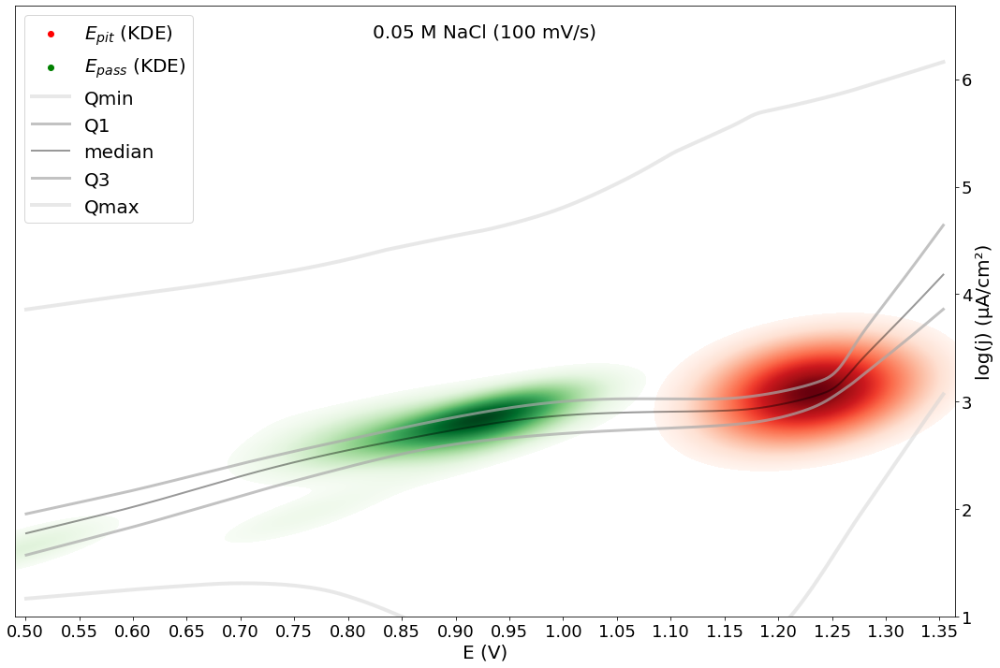

In [316]:
resolution=abs(np.diff(pit_pass_log["Epit_y"])).min() # this bin sizing strategy is risky (very heavy)
nbins= round((pit_pass_log["Epit_y"].max()-pit_pass_log["Epit_y"].min())/resolution)
resolutionpass=abs(np.diff(pit_pass_log["Epass_y"].dropna())).min()
nbinspass= round((pit_pass_log["Epass_y"].max()-pit_pass_log["Epass_y"].dropna().min())/resolutionpass)

k = kde.gaussian_kde([pit_pass_log["Epit_x"],pit_pass_log["Epit_y"]])
xipit, yipit = np.mgrid[pit_pass_log["Epit_x"].min()-0.08:pit_pass_log["Epit_x"].max()+0.08:nbins*1j, pit_pass_log["Epit_y"].min():pit_pass_log["Epit_y"].max()+0.08:nbins*1j]
zipit = k(np.vstack([xipit.flatten(), yipit.flatten()]))
z = np.ma.masked_array(zipit, zipit < 0.53)

k2 = kde.gaussian_kde([pit_pass_log["Epass_x"].dropna(),pit_pass_log["Epass_y"].dropna()])
xipass, yipass = np.mgrid[pit_pass_log["Epass_x"].min()-0.08:pit_pass_log["Epass_x"].max()+0.08:nbinspass*1j, pit_pass_log["Epass_y"].min()-0.8:pit_pass_log["Epass_y"].max()+0.8:nbins*1j]
zipass = k2(np.vstack([xipass.flatten(), yipass.flatten()]))
z2 = np.ma.masked_array(zipass, zipass < 0.53)

fig, ax = plt.subplots(figsize=(18, 12))

plt.pcolormesh(xipit, yipit, z.reshape(xipit.shape), shading='auto',cmap="Reds") 
plt.pcolormesh(xipass, yipass, z2.reshape(xipass.shape), shading='auto',cmap="Greens")

ax.scatter(0,0,color="red",label="$E_{pit}$ (KDE)") # plot for the sake of the legend label
ax.scatter(0,0,color="green",label="$E_{pass}$ (KDE)") # plot for the sake of the legend label

ax.plot(E , IQR_ylow_log["Qmin"],color="lightgrey",linewidth=4,label="Qmin",alpha=0.5,zorder=1)    
ax.plot(E , IQR_ylow_log["Q1"], color="darkgray",linewidth=3,label="Q1",alpha=0.7,zorder=1) 
ax.plot(E , IQR_ylow_log["median"], color="k",linewidth=2,label="median",alpha=0.4,zorder=1) 
ax.plot(E , IQR_ylow_log["Q3"],color="darkgray",linewidth=3,label="Q3",alpha=0.7,zorder=1) 
ax.plot(E , IQR_ylow_log["Qmax"], color="lightgrey",linewidth=4,label="Qmax",alpha=0.5,zorder=1) 

ax.legend( loc ="upper left",prop={'size': 20})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=18)
ax.xaxis.label.set_size(20)
ax.yaxis.label.set_size(20)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 20, y=0.94)
ax.yaxis.tick_right()
ax.yaxis.set_label_position("right")

## Epit and Epass estimations from the IQR and selected quantiles

### Epit

#### ML

In [317]:
Xquantile_min=np.nanpercentile(j_transp_scaled, 0.35,axis=0) 
XQ1=np.nanpercentile(j_transp_scaled,25,axis=0)
Xmedian=np.nanpercentile(j_transp_scaled,50,axis=0)
XQ3=np.nanpercentile(j_transp_scaled,75,axis=0)
Xquantile_max=np.nanpercentile(j_transp_scaled, 99.65,axis=0)
Xmean=np.mean(j_transp_scaled,axis=0)
XIQR=pd.DataFrame({"Qmin":Xquantile_min,"Q1":XQ1,"median":Xmedian,"Q3":XQ3,"Qmax":Xquantile_max,"mean":Xmean}) 
XIQR=XIQR.T
XIQR.columns=j_transp_scaled.columns
XIQR  

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
Qmin,-3.857972e+00,-3.860537e+00,-3.864321e+00,-3.866801e+00,-3.870458e+00,-3.872854e+00,-3.876386e+00,-3.878701e+00,-3.882115e+00,-3.885459e+00,...,-2.283364e+00,-2.276275e+00,-2.265628e+00,-2.258519e+00,-2.247844e+00,-2.240721e+00,-2.230022e+00,-2.222886e+00,-2.212172e+00,-2.205026e+00
Q1,-6.741035e-02,-6.882016e-02,-7.092437e-02,-7.232033e-02,-7.440345e-02,-7.578508e-02,-7.784696e-02,-7.921432e-02,-8.125474e-02,-8.328201e-02,...,-4.569974e-01,-4.578379e-01,-4.596435e-01,-4.608812e-01,-4.627275e-01,-4.639515e-01,-4.657784e-01,-4.669896e-01,-4.687973e-01,-4.699961e-01
median,2.050877e-01,2.061351e-01,2.076943e-01,2.087257e-01,2.102602e-01,2.112747e-01,2.127834e-01,2.137801e-01,2.152617e-01,2.150711e-01,...,-1.950558e-01,-1.945977e-01,-1.949257e-01,-1.959406e-01,-1.978488e-01,-1.991137e-01,-2.010010e-01,-2.028936e-01,-2.068735e-01,-2.078449e-01
Q3,4.454154e-01,4.458311e-01,4.464458e-01,4.468498e-01,4.471420e-01,4.467979e-01,4.462867e-01,4.459492e-01,4.454480e-01,4.453188e-01,...,2.989985e-01,3.026500e-01,3.080927e-01,3.116992e-01,3.170760e-01,3.206390e-01,3.259539e-01,3.294758e-01,3.347295e-01,3.382117e-01
Qmax,3.103823e+00,3.100128e+00,3.094650e+00,3.091041e+00,3.085696e+00,3.082179e+00,3.076974e+00,3.073550e+00,3.068485e+00,3.063504e+00,...,3.725641e+00,3.713313e+00,3.694767e+00,3.682367e+00,3.663717e+00,3.651629e+00,3.642003e+00,3.635537e+00,3.625758e+00,3.619191e+00
mean,1.264016e-15,-1.566142e-15,6.515735e-16,-6.970745e-16,8.099168e-17,-7.002595e-16,-1.737226e-15,-2.024792e-16,1.706285e-17,5.979962e-16,...,-6.461134e-16,-1.619834e-16,-3.330669e-16,4.058684e-16,2.639055e-16,-6.961644e-16,-1.747236e-16,1.683535e-16,3.048563e-16,1.218515e-15


#### selection of input features 

In [318]:
# reducing the complexity of the IQR curves by diminishing its dimensionality: selecting every 40th feature from the "XIQR" df
XIQR_red=XIQR.copy()
XIQR_red=XIQR_red[np.arange(0,XIQR.shape[1],40)]
XIQR_red

,0,40,80,120,160,200,240,280,320,360,400,440,480
Qmin,-3.857972e+00,-3.950081e+00,-4.033330e+00,-4.261902e+00,-4.450187e+00,-4.537818e+00,-4.486140e+00,-4.330759e+00,-3.964164e+00,-3.680547e+00,-3.157529e+00,-2.694941e+00,-2.374469e+00
Q1,-6.741035e-02,-7.252032e-02,-8.009604e-02,-1.027581e-01,-1.119711e-01,-1.154126e-01,-1.239023e-01,-1.599432e-01,-1.793310e-01,-2.368041e-01,-3.215867e-01,-4.088926e-01,-4.471914e-01
median,2.050877e-01,2.120385e-01,2.206862e-01,1.964236e-01,1.783552e-01,1.435281e-01,1.116214e-01,6.187623e-02,2.532259e-02,-6.749514e-02,-1.196419e-01,-1.737557e-01,-2.004045e-01
Q3,4.454154e-01,4.451712e-01,4.524342e-01,4.479697e-01,4.189510e-01,3.824004e-01,3.296956e-01,2.626809e-01,1.992678e-01,1.311836e-01,9.020893e-02,1.933438e-01,2.609914e-01
Qmax,3.103823e+00,2.958874e+00,2.872755e+00,2.977567e+00,3.225279e+00,3.532350e+00,3.998359e+00,4.364900e+00,4.720041e+00,4.781094e+00,4.679832e+00,4.414344e+00,3.882938e+00
mean,1.264016e-15,-3.859618e-16,-1.144007e-15,-4.555782e-17,-2.943627e-16,-4.431508e-16,2.985999e-18,-1.723348e-16,8.576928e-17,5.150707e-16,5.733119e-16,-3.048563e-16,4.859501e-16


#### deploying the trained model on the IQR set

In [385]:
predict_IQR=model.predict(XIQR_red) # better retrain the model first
predict_IQR

1/1 [==============================] - 0s 53ms/step


array([[1.1283665],
       [1.2146058],
       [1.2192028],
       [1.2196624],
       [1.1485476],
       [1.2201612]], dtype=float32)

### Epass

#### ML

In [321]:
Xquantile_min_pass=np.nanpercentile(j_transp_scaled_pass, 0.35,axis=0) 
XQ1_pass=np.nanpercentile(j_transp_scaled_pass,25,axis=0)
Xmedian_pass=np.nanpercentile(j_transp_scaled_pass,50,axis=0)
XQ3_pass=np.nanpercentile(j_transp_scaled_pass,75,axis=0)
Xquantile_max_pass=np.nanpercentile(j_transp_scaled_pass, 99.65,axis=0) 
Xmean_pass=np.mean(j_transp_scaled_pass,axis=0)
XIQR_pass=pd.DataFrame({"Qmin":Xquantile_min_pass,"Q1":XQ1_pass,"median":Xmedian_pass,"Q3":XQ3_pass,"Qmax":Xquantile_max_pass,"mean":Xmean_pass}) 
XIQR_pass=XIQR_pass.T
XIQR_pass.columns=j_transp_scaled_pass.columns
XIQR_pass 

,0,1,2,3,4,5,6,7,8,9,...,690,691,692,693,694,695,696,697,698,699
Qmin,-2.005838e+00,-2.009138e+00,-2.014041e+00,-2.017272e+00,-2.022059e+00,-2.026762e+00,-2.029844e+00,-2.034379e+00,-2.037337e+00,-2.041665e+00,...,-2.832870e+00,-2.823355e+00,-2.816972e+00,-2.807343e+00,-2.800886e+00,-2.791140e+00,-2.784605e+00,-2.774741e+00,-2.768127e+00,-2.758145e+00
Q1,-4.276470e-01,-4.276811e-01,-4.285301e-01,-4.313020e-01,-4.336392e-01,-4.337022e-01,-4.337238e-01,-4.337229e-01,-4.336988e-01,-4.336258e-01,...,-3.779788e-01,-3.802883e-01,-3.818314e-01,-3.841494e-01,-3.856969e-01,-3.880216e-01,-3.895728e-01,-3.919026e-01,-3.934568e-01,-3.957899e-01
median,-1.779733e-01,-1.770745e-01,-1.756834e-01,-1.747244e-01,-1.732327e-01,-1.716706e-01,-1.705867e-01,-1.688924e-01,-1.677158e-01,-1.664385e-01,...,2.158529e-02,1.840020e-02,1.625772e-02,1.301727e-02,1.083869e-02,7.542674e-03,5.327329e-03,1.975964e-03,-2.759301e-04,-1.253047e-03
Q3,2.793556e-01,2.794388e-01,2.795753e-01,2.796749e-01,2.798383e-01,2.800196e-01,2.801507e-01,2.801467e-01,2.798606e-01,2.794118e-01,...,3.998343e-01,4.010798e-01,3.995908e-01,3.973385e-01,3.958241e-01,3.935325e-01,3.919918e-01,3.896601e-01,3.880926e-01,3.857206e-01
Qmax,4.704718e+00,4.700695e+00,4.694646e+00,4.690605e+00,4.684533e+00,4.678449e+00,4.674387e+00,4.668286e+00,4.664212e+00,4.658093e+00,...,4.823458e+00,4.840560e+00,4.851952e+00,4.869011e+00,4.880365e+00,4.897368e+00,4.908677e+00,4.925607e+00,4.936863e+00,4.953703e+00
mean,3.310665e-16,2.281958e-15,-7.021410e-16,-5.346074e-16,-8.961800e-16,2.595521e-16,8.501708e-17,1.096220e-15,7.696546e-16,-1.194240e-15,...,2.146431e-15,-2.205443e-15,1.139229e-15,-9.346878e-16,-3.018106e-15,5.921189e-16,-7.406488e-16,1.293760e-15,-1.775857e-15,-1.191739e-15


In [322]:
# reducing the complexity of the IQR curves by diminishing its dimensionality: selecting every 60th feature from the "XIQR_pass" df
XIQR_pass_red=XIQR_pass.copy()
XIQR_pass_red=XIQR_pass_red[np.arange(0,XIQR_pass.shape[1],60)]
XIQR_pass_red

,0,60,120,180,240,300,360,420,480,540,600,660
Qmin,-2.005838e+00,-2.273330e+00,-2.447454e+00,-2.370374e+00,-2.608920e+00,-3.090287e+00,-3.397784e+00,-3.509974e+00,-3.775966e+00,-3.974785e+00,-3.613088e+00,-3.069171e+00
Q1,-4.276470e-01,-3.987795e-01,-4.175062e-01,-3.783714e-01,-3.168718e-01,-2.874162e-01,-2.620973e-01,-2.325612e-01,-2.952465e-01,-3.696376e-01,-3.880934e-01,-3.760522e-01
median,-1.779733e-01,-8.488090e-02,-6.636009e-03,3.782336e-02,3.297819e-02,1.042816e-01,9.030184e-02,9.830154e-02,1.601657e-01,1.479159e-01,1.020765e-01,7.957883e-02
Q3,2.793556e-01,2.747599e-01,3.360452e-01,3.500322e-01,3.399673e-01,3.640460e-01,4.480525e-01,4.613754e-01,5.166419e-01,5.453346e-01,5.269227e-01,4.487180e-01
Qmax,4.704718e+00,4.385859e+00,4.122794e+00,4.113108e+00,4.262508e+00,4.290845e+00,4.010973e+00,3.617005e+00,3.267020e+00,3.095984e+00,3.674628e+00,4.384682e+00
mean,3.310665e-16,8.966801e-16,9.801969e-16,1.150231e-15,1.063214e-15,1.164234e-15,1.630328e-16,-6.201246e-17,-6.556317e-16,1.639829e-15,2.005903e-15,1.493300e-15


#### deploying the trained model on the IQR set

In [386]:
predict_IQR_pass=model_pass.predict(XIQR_pass_red)  
predict_IQR_pass

1/1 [==============================] - 0s 36ms/step


array([[0.87320155],
       [0.86945873],
       [0.9278386 ],
       [0.88703066],
       [0.7721351 ],
       [0.9193036 ]], dtype=float32)

#### storing the Epit (x,y) and Epass (x,y) values of the IQR curves in a df 

In [387]:
index_names =  XIQR.index 

Epit_x_IQR, Epit_y_IQR = [],[]
for e,(index,column) in zip(predict_IQR,enumerate(index_names)):
    Epit_x_IQR.append(e[0])
    Epit_y_IQR.append(IQR_ylow_log[column][E>=predict_IQR[index][0]].iloc[0])

index_names_pass =  XIQR_pass.index 

Epass_x_IQR, Epass_y_IQR = [],[]
for e,(index,column) in zip(predict_IQR_pass,enumerate(index_names_pass)):
    Epass_x_IQR.append(e[0])
    Epass_y_IQR.append(IQR_ylow_log[column][E>=predict_IQR_pass[index][0]].iloc[0])
    
pit_pass_IQR = pd.DataFrame({"Epit_x":Epit_x_IQR,"Epit_y":Epit_y_IQR,"Epass_x":Epass_x_IQR,"Epass_y":Epass_y_IQR})
pit_pass_IQR.index=XIQR.index
pit_pass_IQR.index.name="IQR"
pit_pass_IQR.iloc[4,2:]=np.nan # Qmax: no Epass
pit_pass_IQR

,Epit_x,Epit_y,Epass_x,Epass_y
IQR,,,,
Qmin,1.128366,0.397710,0.873202,0.889697
Q1,1.214606,2.886013,0.869459,2.551671
median,1.219203,3.011408,0.927839,2.785668
Q3,1.219662,3.132351,0.887031,2.830199
Qmax,1.148548,5.528860,NaN,NaN
mean,1.220161,3.082480,0.919304,2.683374


In [389]:
# choosing the directory for uploading the IQR dataset originally produced (to account for the stochastic nature of ANN outputs)
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")

pit_pass_IQR=pd.read_csv('Epit_Epass_005_100_IQR.csv',index_col=0) 
pit_pass_IQR

,Epit_x,Epit_y,Epass_x,Epass_y
IQR,,,,
Qmin,1.150442,0.490635,0.702231,1.308284
Q1,1.220408,2.904874,0.920438,2.575107
median,1.230246,3.042607,0.914945,2.724834
Q3,1.234303,3.174928,0.903348,2.826566
Qmax,1.046722,5.011973,NaN,NaN
mean,1.200496,3.019910,0.886596,2.641560


## central tendency estimates of Epass/log(jpass) and Epit/log(jpit)
### comparison of estimates from the maximum KDE (ground truth) with the median and mean proxy models

In [390]:
#median absolute deviation 
from scipy.stats import median_abs_deviation

df_mad=median_abs_deviation(df_log,axis=1)

Text(0.5, 1.0, '0.05 M NaCl (100 mV/s)')

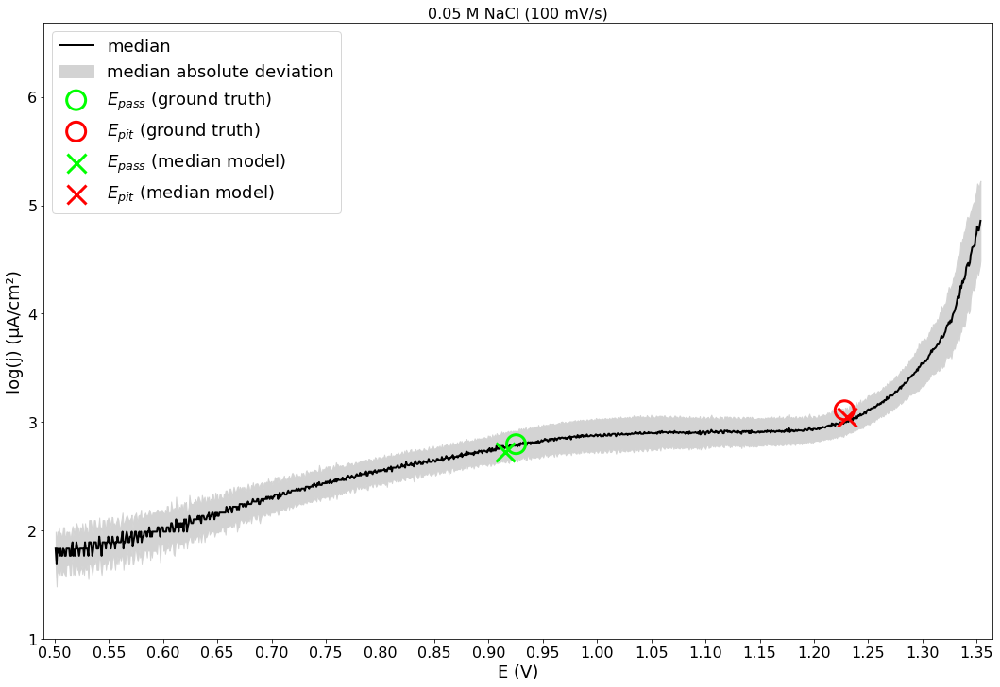

In [398]:
fig, ax = plt.subplots(figsize=(18, 12))

ax.plot(E,IQR["median"], color="k",linewidth=2,label="median")
ax.fill_between(E, IQR["median"]-df_mad, IQR["median"]+df_mad,color="lightgrey",label="median absolute deviation")

ax.scatter(Epass_x_kde,Epass_y_kde,marker="o",facecolors='none',edgecolors="lime",s=400,label="$E_{pass}$ (ground truth)",linewidths=3,zorder=2)
ax.scatter(Epit_x_kde,Epit_y_kde,marker="o",facecolors='none',edgecolors="r",s=400,label="$E_{pit}$ (ground truth)",linewidths=3,zorder=2)

ax.scatter(pit_pass_IQR.loc["median"]["Epass_x"],pit_pass_IQR.loc["median"]["Epass_y"],marker="x",c="lime",s=400,label="$E_{pass}$ (median model)",linewidths=3,zorder=2)
ax.scatter(pit_pass_IQR.loc["median"]["Epit_x"],pit_pass_IQR.loc["median"]["Epit_y"],marker="x",c="red",s=400,label="$E_{pit}$ (median model)",linewidths=3,zorder=2)

ax.legend( loc ="upper left",prop={'size': 18})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=16)
ax.xaxis.label.set_size(18)
ax.yaxis.label.set_size(18)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 16)

In [392]:
#standard deviation 
df_std=np.std(df_log,axis=1)
    
#standard error of the mean 
from scipy.stats import sem
df_sem=sem(df_log,axis=1) 

Text(0.5, 1.0, '0.05 M NaCl (100 mV/s)')

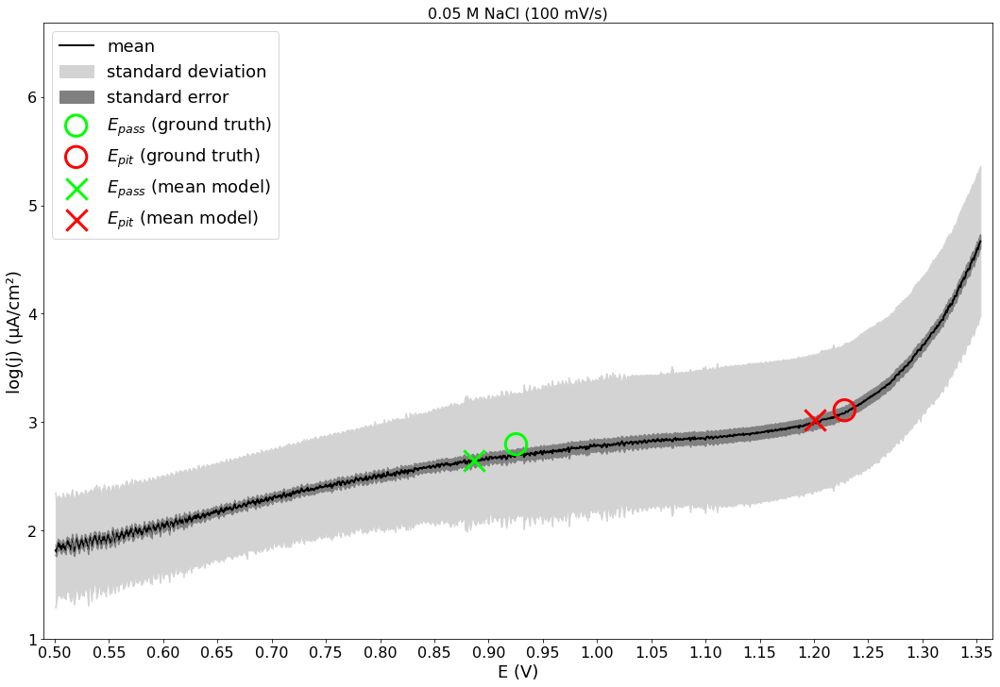

In [393]:
fig, ax = plt.subplots(figsize=(18, 12))
ax.plot(E,m, color="k",linewidth=2,label="mean")

ax.plot(E,m+df_std, color="lightgrey",linewidth=1)
ax.plot(E,m-df_std, color="lightgrey",linewidth=1)
ax.fill_between(E,  m-df_std, m+df_std,color="lightgrey",label="standard deviation")

ax.plot(E,m+df_sem, color="grey",linewidth=1)
ax.plot(E,m-df_sem, color="grey",linewidth=1)
ax.fill_between(E, m-df_sem, m+df_sem,color="grey",label="standard error")

ax.scatter(Epass_x_kde,Epass_y_kde,marker="o",facecolors='none',edgecolors="lime",s=500,label="$E_{pass}$ (ground truth)",linewidths=3,zorder=2)
ax.scatter(Epit_x_kde,Epit_y_kde,marker="o",facecolors='none',edgecolors="r",s=500,label="$E_{pit}$ (ground truth)",linewidths=3,zorder=2)

ax.scatter(pit_pass_IQR.loc["mean"]["Epass_x"],pit_pass_IQR.loc["mean"]["Epass_y"],marker="x",c="lime",s=500,linewidths=3,zorder=2,label="$E_{pass}$ (mean model)")
ax.scatter(pit_pass_IQR.loc["mean"]["Epit_x"],pit_pass_IQR.loc["mean"]["Epit_y"],marker="x",c="red",s=500,label="$E_{pit}$ (mean model)",linewidths=3,zorder=2)

ax.legend( loc ="upper left",prop={'size': 18})
ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=16)
ax.xaxis.label.set_size(18)
ax.yaxis.label.set_size(18)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) 
ax.set_xlim(0.5-0.01,1.3544115+0.01) 
ax.set_ylim(np.log10(10), np.log10(4800000)) 

ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 16)

### storing the ground truth values of Epass/log(jpass) and Epit/log(jpit) and the mean-/median-based estimates in a df (and exporting it as a CSV file)

In [394]:
residuals_mean_median = pd.DataFrame(
[[Epass_x_kde,
Epass_y_kde,
Epit_x_kde,
Epit_y_kde,
pit_pass_IQR.loc["median"]["Epass_x"],
pit_pass_IQR.loc["median"]["Epass_y"],
pit_pass_IQR.loc["median"]["Epit_x"],
pit_pass_IQR.loc["median"]["Epit_y"],
pit_pass_IQR.loc["mean"]["Epass_x"],
pit_pass_IQR.loc["mean"]["Epass_y"],
pit_pass_IQR.loc["mean"]["Epit_x"],
pit_pass_IQR.loc["mean"]["Epit_y"],
Epass_x_kde-pit_pass_IQR.loc["median"]["Epass_x"],
Epass_y_kde-pit_pass_IQR.loc["median"]["Epass_y"],
Epit_x_kde-pit_pass_IQR.loc["median"]["Epit_x"],
Epit_y_kde-pit_pass_IQR.loc["median"]["Epit_y"],
Epass_x_kde-pit_pass_IQR.loc["mean"]["Epass_x"],
Epass_y_kde-pit_pass_IQR.loc["mean"]["Epass_y"],
Epit_x_kde-pit_pass_IQR.loc["mean"]["Epit_x"],
Epit_y_kde-pit_pass_IQR.loc["mean"]["Epit_y"]]], 
columns=["Epass","jpass","Epit","jpit",
        'median Epass','median jpass','median Epit','median jpit','mean Epass','mean jpass','mean Epit','mean jpit',
        'median Epass res','median jpass res','median Epit res','median jpit res','mean Epass res','mean jpass res','mean Epit res','mean jpit res'],
index=[3])
# choosing the directory 
os.chdir(r"C:\Users\lbertolu\OneDrive - Vrije Universiteit Brussel\ULB\SECCM tests\pitting statistics paper draft\pape2")
residuals_mean_median.to_csv('residuals_mean_median_005_100.csv', index=True)
residuals_mean_median

,Epass,jpass,Epit,jpit,median Epass,median jpass,median Epit,median jpit,mean Epass,mean jpass,mean Epit,mean jpit,median Epass res,median jpass res,median Epit res,median jpit res,mean Epass res,mean jpass res,mean Epit res,mean jpit res
3,0.925333,2.79519,1.228127,3.108,0.914945,2.724834,1.230246,3.042607,0.886596,2.64156,1.200496,3.01991,0.010388,0.070356,-0.002119,0.065393,0.038737,0.15363,0.027631,0.08809


# Schematic of the data distribution illustrating how high outliers shift the conditional mean of log(j) from the regions with highest data density

### data density estimated by KDE (proportional to the colourmap)

Text(0.5, 1.0, '0.05 M NaCl (100 mV/s)')

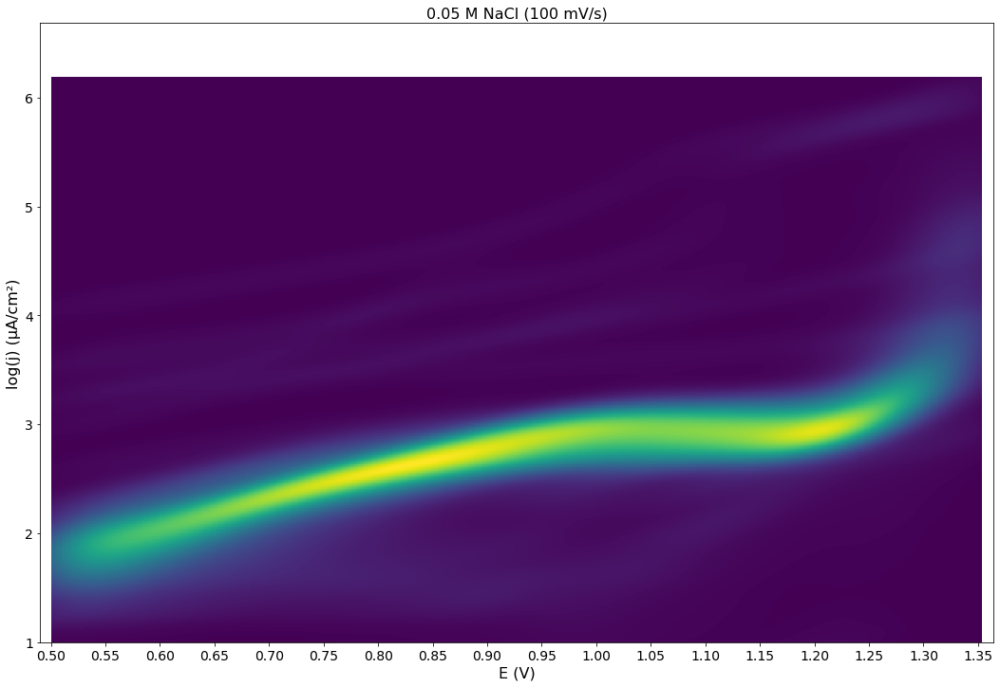

In [302]:
ar = list(np.concatenate(df_log.to_numpy()).flat)
E_ar=np.repeat(E,df_log.shape[1])

# Evaluate a gaussian KDE on a regular grid of nbins x nbins over data extents
nbins= df_log.shape[0]

k = kde.gaussian_kde([E_ar,ar])
xi, yi = np.mgrid[E.min():E.max():nbins*1j,df_log.min().min():df_log.max().max():nbins*1j]
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
    
# Make the plot
fig, ax = plt.subplots(figsize=(18, 12))
plt.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto')

ax.set_ylabel("log(j) (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='both', which='major', labelsize=14)
ax.xaxis.label.set_size(16)
ax.yaxis.label.set_size(16)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) # 
ax.set_xlim(0.5-0.01,1.3544115+0.01) # 
ax.set_ylim(np.log10(10), np.log10(4800000))  
plt.title("0.05 M NaCl (100 mV/s)",fontsize = 16)

### population of the log(j) Vs E curves superimposed to the conditional mean and median of log(j)

(10, 4800000)

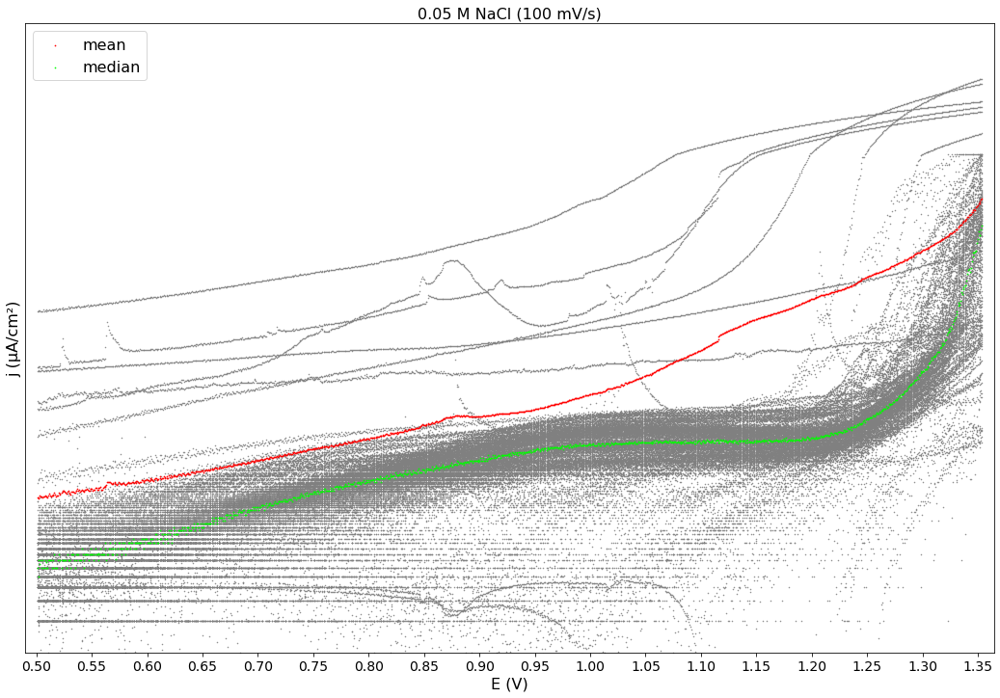

In [395]:
mt_extrap=df.mean(axis=1) 
median_extrap=np.nanpercentile(df,50,axis=1)

rest_extrap=df.subtract(mt_extrap, axis = 0) 
rest_extrap=rest_extrap.abs()
sum_rest_extrap=rest_extrap.sum(axis=0)
sum_rest_extrap.sort_values(inplace=True) 

sum_rest_extrap.index=sum_rest_extrap.index.astype(int)

fig, ax = plt.subplots(figsize=(18, 12))
for r in (sum_rest_extrap.index):
    ax.scatter(E,df.iloc[:,r], color="grey",marker='.',s=1)

ax.scatter(E,mt_extrap, color="red",marker='.',s=2,label="mean")
ax.scatter(E,median_extrap, color="lime",marker='.',s=2,label="median")
ax.legend( loc ="upper left",prop={'size': 16})

ax.set_yscale('log')
ax.set_ylabel("j (µA/cm²)")
ax.set_xlabel("E (V)")
ax.tick_params(axis='x', which='major', labelsize=14)
ax.tick_params(axis='y', which='both',left=False, labelleft=False)
ax.xaxis.label.set_size(16)
ax.yaxis.label.set_size(16)

ax.set_xticks(np.arange(0.5,1.3544115,0.05)) # 
ax.set_xlim(0.5-0.01,1.3544115+0.01) # 

ax.set_title("0.05 M NaCl (100 mV/s)",fontsize = 16)
ax.set_ylim(10, 4800000)  